# Exploratory Data Analysis #2: Comparison of Semantic, Emotional, and Lexicon-Based Features (On Five Fake News Datasets) for Improved Cross-Domain Fake News Detection with Feature Engineering and Selection Techniques

In this section, I will proceed with the exploratory data analysis comparing the distributions of textual features between fake and real news in all the datasets used for this project. While in the previous section, I focused on surface text statistics (e.g. word lengths) and grammatical features, in this analysis I will use a lexicon-based approach to highlight differences between the *semantic* rather than the lexical and syntactic textual features.

In [1]:
# Imports the required libraries
import os

# Imports basic text data analysis libraries:
import pandas as pd
import numpy as np
from tqdm import tqdm
# Shows the progress of applying different functions for processing an entire column in pandas
tqdm.pandas()
# Imports library for measuring how long processes take
import time

# Imports basic NLP libraries and downloading NLTK packages:
import nltk
from nltk.probability import FreqDist
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
nltk.download("punkt") # For word_tokenize
nltk.download("averaged_perceptron_tagger")
nltk.download("universal_tagset")
nltk.download("stopwords")
# Gets the set of stopwords for English (set = more efficient processing)
stopwords_set = set(stopwords.words('english'))


# Downloads VADER for sentiment polarity scores
nltk.download("vader_lexicon")
from nltk.sentiment.vader import SentimentIntensityAnalyzer
# Downloads SpaCy for Named-Entity Recognition analysis
import spacy
# NRC emotion lexicon for 8 categories of emotions
from nrclex import NRCLex
# TextBlob for subjectivity scores
from textblob import TextBlob
# Spellchecker for getting the frequency counts of misspelled words
from spellchecker import SpellChecker
# Important library for decoding text files (toxic word .txt file has a weird encoding)
import chardet

# Visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import textwrap 

[nltk_data] Downloading package punkt to /Users/ophelia/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/ophelia/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package universal_tagset to
[nltk_data]     /Users/ophelia/nltk_data...
[nltk_data]   Package universal_tagset is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/ophelia/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/ophelia/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [2]:
# Loads in all of the training datasets for feature extraction and comparison

# Sets up the root full-scale dataset path on my machine
root_fullscale_path = "../FPData/"

###################################### FULL-SCALE (Single Dataset) TRAINING DATA PATHS ###########################################################
welfake_train_path = os.path.join(root_fullscale_path, "WELFake/clean_all_train_wf.csv")
welfake_test_path = os.path.join(root_fullscale_path, "WELFake/clean_test_wf.csv")

fakeddit_train_path = os.path.join(root_fullscale_path, "Fakeddit/clean_all_train.csv")
fakeddit_test_path = os.path.join(root_fullscale_path, "Fakeddit/clean_test.csv")

constraint_train_path = os.path.join(root_fullscale_path, "Constraint/clean_all_train.csv")
constraint_test_path = os.path.join(root_fullscale_path, "Constraint/clean_test.csv")

politifact_train_path = os.path.join(root_fullscale_path, "PolitiFact/clean_all_train_pf.csv")
politifact_test_path = os.path.join(root_fullscale_path, "PolitiFact/clean_test_pf.csv")

gossipcop_train_path = os.path.join(root_fullscale_path, "GossipCop/clean_all_train_gc.csv")
gossipcop_test_path = os.path.join(root_fullscale_path, "GossipCop/clean_test_gc.csv")

###################################### FEW-SHOT TRAINING DATA PATHS ############################################################################
root_fewshot_path = "../FPData/CleanFewShotDatasets_withoutValSets/"
welfake_target_fiveshot_path = os.path.join(root_fewshot_path, "five_shot_train_data_except_welfake.csv")
fakeddit_target_fiveshot_path = os.path.join(root_fewshot_path, "five_shot_train_data_except_fakeddit.csv")
constraint_target_fiveshot_path = os.path.join(root_fewshot_path, "five_shot_train_data_except_constraint.csv")
politifact_target_fiveshot_path = os.path.join(root_fewshot_path, "five_shot_train_data_except_politifact.csv")
gossipcop_target_fiveshot_path = os.path.join(root_fewshot_path, "five_shot_train_data_except_gossipcop.csv")

root_zeroshot_path = "../FPData/CleanZeroShotDatasets_withoutValSets/"
welfake_target_zeroshot_path = os.path.join(root_zeroshot_path, "zero_shot_train_data_except_welfake.csv")
fakeddit_target_zeroshot_path = os.path.join(root_zeroshot_path, "zero_shot_train_data_except_fakeddit.csv")
constraint_target_zeroshot_path = os.path.join(root_zeroshot_path, "zero_shot_train_data_except_constraint.csv")
politifact_target_zeroshot_path = os.path.join(root_zeroshot_path, "zero_shot_train_data_except_politifact.csv")
gossipcop_target_zeroshot_path = os.path.join(root_zeroshot_path, "zero_shot_train_data_except_gossipcop.csv")

########################################################################################################################################################

# Loads in full-scale training datasets
wf_df_train = pd.read_csv(welfake_train_path)
fe_df_train = pd.read_csv(fakeddit_train_path)
ct_df_train = pd.read_csv(constraint_train_path)
pf_df_train = pd.read_csv(politifact_train_path)
gc_df_train = pd.read_csv(gossipcop_train_path)

# Loads in ull-scale test datasets
wf_df_test = pd.read_csv(welfake_test_path)
fe_df_test = pd.read_csv(fakeddit_test_path)
ct_df_test = pd.read_csv(constraint_test_path)
pf_df_test= pd.read_csv(politifact_test_path)
gc_df_test = pd.read_csv(gossipcop_test_path)

# Concatenates (train AND test) full-scale datasets
wf_df = pd.concat([wf_df_train, wf_df_test], ignore_index=True)
fe_df = pd.concat([fe_df_train, fe_df_test], ignore_index=True)
ct_df = pd.concat([ct_df_train, ct_df_test], ignore_index=True)
pf_df = pd.concat([pf_df_train, pf_df_test], ignore_index=True)
gc_df = pd.concat([gc_df_train, gc_df_test], ignore_index=True)

# Loads in five-shot training datasets
wf_target_fiveshot_df = pd.read_csv(welfake_target_fiveshot_path)
fe_target_fiveshot_df = pd.read_csv(fakeddit_target_fiveshot_path)
ct_target_fiveshot_df = pd.read_csv(constraint_target_fiveshot_path)
pf_target_fiveshot_df = pd.read_csv(politifact_target_fiveshot_path)
gc_target_fiveshot_df = pd.read_csv(gossipcop_target_fiveshot_path)

# Loads in zero-shot training datasets
wf_target_zeroshot_df = pd.read_csv(welfake_target_zeroshot_path)
fe_target_zeroshot_df = pd.read_csv(fakeddit_target_zeroshot_path)
ct_target_zeroshot_df = pd.read_csv(constraint_target_zeroshot_path)
pf_target_zeroshot_df = pd.read_csv(politifact_target_zeroshot_path)
gc_target_zeroshot_df = pd.read_csv(gossipcop_target_zeroshot_path)

In [3]:
# Splits the datasets into real vs fake news for comparing differences between features for the two categories

# WELFake
wf_df_real = wf_df[wf_df["label"] == 0]
wf_df_fake = wf_df[wf_df["label"] == 1]

# Fakeddit
fe_df_real = fe_df[fe_df["label"] == 0]
fe_df_fake = fe_df[fe_df["label"] == 1]

# Constraint
ct_df_real = ct_df[ct_df["label"] == 0]
ct_df_fake = ct_df[ct_df["label"] == 1]

# PolitiFact
pf_df_real = pf_df[pf_df["label"] == 0]
pf_df_fake = pf_df[pf_df["label"] == 1]

# GossipCop
gc_df_real = gc_df[gc_df["label"] == 0]
gc_df_fake = gc_df[gc_df["label"] == 1]

# Five-shot: WELFake target
wf_tgt_5shot_df_real = wf_target_fiveshot_df[wf_target_fiveshot_df["label"] == 0]
wf_tgt_5shot_df_fake = wf_target_fiveshot_df[wf_target_fiveshot_df["label"] == 1]

# Five-shot: Fakeddit target
fe_tgt_5shot_df_real = fe_target_fiveshot_df[fe_target_fiveshot_df["label"] == 0]
fe_tgt_5shot_df_fake = fe_target_fiveshot_df[fe_target_fiveshot_df["label"] == 1]

# Five-shot: Constraint target
ct_tgt_5shot_df_real = ct_target_fiveshot_df[ct_target_fiveshot_df["label"] == 0]
ct_tgt_5shot_df_fake = ct_target_fiveshot_df[ct_target_fiveshot_df["label"] == 1]

# Five-shot: PolitiFact target
pf_tgt_5shot_df_real = pf_target_fiveshot_df[pf_target_fiveshot_df["label"] == 0]
pf_tgt_5shot_df_fake = pf_target_fiveshot_df[pf_target_fiveshot_df["label"] == 1]

# Five-shot: GossipCop target
gc_tgt_5shot_df_real = gc_target_fiveshot_df[gc_target_fiveshot_df["label"] == 0]
gc_tgt_5shot_df_fake = gc_target_fiveshot_df[gc_target_fiveshot_df["label"] == 1]

# Zero-shot: WELFake target
wf_tgt_0shot_df_real = wf_target_zeroshot_df[wf_target_zeroshot_df["label"] == 0]
wf_tgt_0shot_df_fake = wf_target_zeroshot_df[wf_target_zeroshot_df["label"] == 1]

# Zero-shot: Fakeddit target
fe_tgt_0shot_df_real = fe_target_zeroshot_df[fe_target_zeroshot_df["label"] == 0]
fe_tgt_0shot_df_fake = fe_target_zeroshot_df[fe_target_zeroshot_df["label"] == 1]

# Zero-shot: Constraint target
ct_tgt_0shot_df_real = ct_target_zeroshot_df[ct_target_zeroshot_df["label"] == 0]
ct_tgt_0shot_df_fake = ct_target_zeroshot_df[ct_target_zeroshot_df["label"] == 1]

# Zero-shot: PolitiFact target
pf_tgt_0shot_df_real = pf_target_zeroshot_df[pf_target_zeroshot_df["label"] == 0]
pf_tgt_0shot_df_fake = pf_target_zeroshot_df[pf_target_zeroshot_df["label"] == 1]

# Zero-shot: GossipCop target
gc_tgt_0shot_df_real = gc_target_zeroshot_df[gc_target_zeroshot_df["label"] == 0]
gc_tgt_0shot_df_fake = gc_target_zeroshot_df[gc_target_zeroshot_df["label"] == 1]

## 1. Extracting Sentiment Scores using Lexicons

I will begin by extracting the sentiment polarity (negative to positive) for the fake news vs real news articles for each of the datasets used for the project. I hope to detect the patterns in sentiment scores which generalize best across all datasets. I will use the VADER (Valence Aware Dictionary and sEntiment Reasoner) sentiment analysis tool, as detailed [here on this Medium article](https://medium.com/@rslavanyageetha/vader-a-comprehensive-guide-to-sentiment-analysis-in-python-c4f1868b0d2e). VADER uses a lexicon/dictionary and rule-based NLP methods to rank the "valence" of a text, with -4 indicating very negative emotion and +4 indicating overwhelmingly positive emotion. It is important *not* to preprocess the texts using techniques such as punctuation removal or lowercasing before applying many of the methods used for this feature analysis and data exploration, as for instance, VADER looks at the use of capital letters and exclamation marks to gauge the intensity of the emotion in a text. VADER is integrated into the NLTK library and can be downloaded using this package just like the other lexicons and sets of words.

In [43]:
class SentimentFeatureAnalyzer:

    """
        Created for extracting and plotting different types of sentiment scores of real vs fake news 
        texts across all the different datasaets.
    """
    
    def __init__(self):
        """
           Initializes and loads in VADER and VAD lexicons.
        """
        # Initializes the VADER sentiment analyzer
        # Reference: https://github.com/cjhutto/vaderSentiment/blob/master/vaderSentiment/vader_lexicon.txt
        self.vader_sent_analyzer = SentimentIntensityAnalyzer()
        print("Finished loading VADER Sentiment Intensity Analyzer.")

        # Loads in the VAD lexicon, downloaded from: https://saifmohammad.com/WebPages/nrc-vad.html on 09/01/2025
        self.vad_dict = {}
        
        # Opens the VAD lexicon file with the stored lexicon
        with open("./vad_lexicon.txt", 'r') as file:
            # Iterates over the tab-separated lines
            for line in file:
                # Extracts the word and its valence, arousal, dominance scores by splitting on the tab character, loads them into a dictionary
                word, v, a, d = line.strip().split("\t")
                # Word is the main key and the value is the dict storing VAD values as key-value pairs
                self.vad_dict[word.lower()] = {
                    "valence": float(v),
                    "arousal": float(a),
                    "dominance": float(d)
                }
        print(f"Finished loading VAD-lexicon with {len(self.vad_dict.keys())} words.")

    def calculateVADERSentimentScores(self, df, dataset_name):
        """
        Calculates the VADER sentiment polarity scores for each text and returns
        a DataFrame containing the mean sentiment polarity ("compound" property) for this dataset,
        with the dataset_name as the index
        
        Input Parameters:
            df (pd.DataFrame): The DataFrame containing the texts for sentiment analysis.
            dataset_name (str): The name of the dataset for the Index of the new averages dict.
        
        Output:
            pd.DataFrame: A DataFrame with the mean VADER sentiment polarity score for the dataset.
        """
        # Creates a copy of original dataset
        sent_df = df.copy()

        # Creates a new column for the sentiment scores
        print(f"Extracting VADER Sentiment Scores for {dataset_name}...")

        #  Extracts the overall sentiment score for the text
        sent_df["vader_score"] = sent_df["text"].progress_apply(
            lambda text: self.vader_sent_analyzer.polarity_scores(text)["compound"]
        )
        
        # Calculates the mean sentiment score for the DataFrame
        mean_vader_sentiment_score = sent_df["vader_score"].mean()

        # Creates a dict with the mean sentiment score
        vader_mean_dict = {
            "dataset_name": [dataset_name],  # Must be wrapped in a list
            "mean_vader_score": [mean_vader_sentiment_score]  # Must be wrapped in a list
        }

        # Converts the dict storing the mean score to a single-line DataFrame (for later concatenation with other DataFrames)
        vader_mean_df = pd.DataFrame(vader_mean_dict)

        # Sets the dataset_name as the index for future concatenation with other DataFrames
        vader_mean_df.set_index("dataset_name", inplace=True)

        return vader_mean_df

    def calculateNRCEmotionLexiconScores(self, df, dataset_name, save_path="../FPData/NRCEmotionScores"):
        
        """
        Calculates the emotion scores for each text in a news DataFrame, using the
        10 emotions using the NRC Lexicon. It then returns the updated DataFrame
        with a column for each emotion, as well as a dictionary and DataFrame storing
        the mean emotion scores for each column for this particular dataset.
        
        Input Parameters:
            df (pd.DataFrame): The DataFrame containing news texts for sentiment analysis.
            dataset_name (str): The name of the dataset for setting the Index of the averages dictionary and new resulting DataFrame.
        
        Output:
            pd.DataFrame: The original DataFrame with added emotion score columns.
            dict: A news dictionary storing the mean emotion scores for this DataFrame.
            pd.DataFrame: A news DataFrame with the mean emotion scores for each of the 10 emotions.
        """
        
        # Creates a copy of the original DataFrame
        emotion_df = df.copy()

        # Defines the NRC emotions we are interested in
        # List of emotions on the NRC GitHub page here: https://github.com/metalcorebear/NRCLex
        emotions = ["anger", "anticipation", "disgust", "fear", "joy", "negative", "positive", "sadness", "surprise", "trust"]

        # Creates a new column in the Emotions DataFrame for each emotion and initialize its values all to 0.0 scores for now
        for emotion in emotions:
            emotion_df[emotion] = 0.0

        # Sets up a tqdm progress bar to track progress of the longgggg emotion extraction process
        with tqdm(total=len(emotion_df), desc=f"Processing NRC Lexicon emotion scores for {dataset_name}...") as progress_bar:
            
            # Loops through each row getting its index to extract the text value
            for idx, row in emotion_df.iterrows():
                
                text = row["text"]
                emotion_obj = NRCLex(text)
                
                # Extracts a dict of emotion scores from the emotion object for this particular text
                affect_frequencies = emotion_obj.affect_frequencies
                
                # Adds the emotion frequencies to the respective columns
                for emotion in emotions:
                    # Returns default 0.0 if emotion is absent from emotions affect freq dict, else returns the text's emotion score
                    emotion_df.at[idx, emotion] = affect_frequencies.get(emotion, 0.0) 

                # Updates the progress bar after processing each row
                progress_bar.update(1)

        # Calculates the mean emotion scores for each emotion across all texts in the dataset
        mean_emotion_scores_dict = emotion_df[emotions].mean().to_dict()

        # Converts the dict to a pandas DataFrame storing the mean emotion scores; use dataset's descriptive name as an Index
        mean_emotion_df = pd.DataFrame([mean_emotion_scores_dict], index=[dataset_name])

        # Saves the mean emotion DataFrame for this specific dataset to disk
        mean_emotion_df.to_csv(os.path.join(save_path, f"{dataset_name}_nrc_emotion_scores.csv"), index=True)

        return emotion_df, mean_emotion_scores_dict, mean_emotion_df



    def calculateVADEmotionLexiconScores(self, df, dataset_name, stop_words, save_path="../FPData/VADEmotionScores"):
        """
        Calculates Valence, Arousal, and Dominance emotion scores for each news text and returns:
        
        Input Parameters:
            df (pd.DataFrame): DataFrame containing texts in the "text" column
            dataset_name (str): Name of the dataset for the index
            stop_words (set): Set of stopwords to exclude from sentiment analysis
            vad_dict (dict): Dictionary containing Valence, Arousal, and Dominance scores for words
            save_path (str): Path to save the VAD mean scores DataFrames
        
        Output:
            tuple: a pandas DataFrame with three VAD score columns, storing normalized score (by text length) for each text,
                   a dictionary with the mean VAD scores for the inputted DataFrame, a pandas DataFrame with 
                   the mean VAD scores and dataset_name as index (for concatenation with the other datasets)
        """
        
        # Creates a copy of the inputted DataFrame
        vad_df = df.copy()
    
        # Creates the three VAD-score columns, and set initial scores to 0.0
        vad_components = ["valence", "arousal", "dominance"]

        # Iterates over the three VAD dimensions
        for vad_component in vad_components:
            vad_df[vad_component] = 0.0
    
        # Tracks the progress with tqdm
        with tqdm(total=len(vad_df), desc=f"Processing VAD scores for {dataset_name}...") as progress_bar:
            
            # Iterates over DataFrame rows and extract the text
            for idx, row in vad_df.iterrows():
                
                # Extracts the the text out of the row
                text = row["text"]
                
                # Tokenizes and lowercases the text to match VAD lexicon words
                words = word_tokenize(text.lower())
                
                # Removes stopwords and non-alphabetic words
                clean_words = [word for word in words if word not in stop_words and word.isalpha()]
    
                # Creates a VAD score dict for this row (text)
                vad_scores = {vad_component: [] for vad_component in vad_components}
    
                # Calculates the VAD scores for each word
                for word in clean_words:  # Only use clean_words for scoring
                    
                    # Checks if the word exists in the saved VAD dictionary
                    if word in self.vad_dict:  
                        
                        # Extracts the valence, arousal, dominance scores for this word and add the components' scores to vad scores dict
                        for vad_component in vad_components:
                            vad_scores[vad_component].append(self.vad_dict[word][vad_component])
    
                # Iterates over the VAD (valence-arousal-dominance) components and normalizes their scores by text length
                for vad_component in vad_components:
                    if vad_scores[vad_component]:  # Ensures that the list of the component's scores is not empty for this text
                        vad_df.at[idx, vad_component] = np.mean(vad_scores[vad_component])
                    else:
                         # Sets the score to 0 if nothing is in the list for this component for this particular text
                        vad_df.at[idx, vad_component] = 0.0
                        
                # Updates tqdm progress bar  
                progress_bar.update(1)
    
        # Calculates the mean scores across all texts
        mean_vad_scores = {
            vad_component: vad_df[vad_component].mean()
            for vad_component in vad_components
        }
        
        # Creates a DataFrame with the mean VAD scores
        mean_vad_df = pd.DataFrame([mean_vad_scores], index=[dataset_name])

        # Creates the save directory if doesn't exist
        os.makedirs(save_path, exist_ok=True)
        
        # Saves the mean VAD scores to .csv for this dataset
        mean_vad_df.to_csv(os.path.join(save_path, f"{dataset_name}_vad_scores.csv"))
        
        return vad_df, mean_vad_scores, mean_vad_df


    def calculateTextBlobSubjectivityScores(self, df, dataset_name):
        """
        Calculates TextBlob subjectivity polarity scores for each text and returns
        a DataFrame containing the mean subjectivity score (from 0.0 to 1.0) for texts in this dataset,
        with the dataset_name as the index
        
        Input Parameters:
            df (pd.DataFrame): The DataFrame containing the texts for sentiment analysis.
            dataset_name (str): The name of the dataset for the Index of the returned verages dict.
        
        Output:
            pd.DataFrame: A DataFrame with the mean TextBlob subjectivity score for the dataset.
        """
        
        # Creates a copy of original dataset for adding new subjectivity column to
        subj_df = df.copy()

        print(f"Extracting Subjectivity Scores for {dataset_name}...")
        
        # Creates a new column for the subjectivity scores
        subj_df["subj_score"] = subj_df["text"].progress_apply(
            lambda text: TextBlob(text).subjectivity
        )
        
        # Calculates the mean subjectivity score for the dataset
        mean_subjectivity_score = subj_df["subj_score"].mean()

        # Creates a new dict with the TextBlob subjectivity score for this dataset
        subj_mean_dict = {
            "dataset_name": [dataset_name],  # Name must be wrapped in a list for dict to DataFrame processing
            "mean_subjectivity_score": [mean_subjectivity_score]
        }

        # Creates a one-row DataFrame containing this dataset's mean subjectivity score, for later concatenation with others
        subj_mean_df = pd.DataFrame(subj_mean_dict)

        # Sets the dataset_name as the index
        subj_mean_df.set_index("dataset_name", inplace=True)

        return subj_mean_df

    

    def plotMeanVADERScoresRealVsFakeNewsSideBySide(self, df):
        """
        Creates a 3x5 grid of bar charts showing mean compound VADER Sentiment Scores for real vs fake news
        across the 5 different datasets and 3 different evaluation scenarios.
    
        Input Parameters:
            df (pd.DataFrame): a DataFrame with mean text VADER sentiment score (compound) for real and fake news across different datasets.
        """

        # Creates the subplots for all 15 datasets and for 3 evaluation scenarios (3 rows, 5 columns)
        fig, axes = plt.subplots(3, 5, figsize=(20, 18))
        
        # Adjusts the space between rows and columns to prevent overlapping
        plt.subplots_adjust(hspace=0.3, wspace=0.3)
    
        # Sets the bar width
        bar_width = 0.4
    
        # Extracts the dataset names and mean scores from the DataFrame
        dataset_names = df.index    
        
        # Gets the number of datasets (that have been split into real-fake news pairs), so divide by 2
        num_datasets = len(dataset_names) // 2

        # Iterates over the total number of datasets
        for i in range(num_datasets):
            
            # Uses the index to extract the real and fake dataset rows
            real_idx = i * 2
            fake_idx = real_idx + 1

            # Extracts the names of the dataset with real news appended to it
            real_dataset_name = dataset_names[real_idx]
            
             # Extract the names of the dataset with fake news appended to it
            fake_dataset_name = dataset_names[fake_idx]

            # Gets the mean VADER Sentiment Score for the real and fake news versions of the dataset 
            real_score = df["mean_vader_score"].iloc[real_idx]
            fake_score = df["mean_vader_score"].iloc[fake_idx]
    
            # Calculate the subplot location out of the 15 subplots based on the dataset index
            row_idx = i // 5  # There are 3 rows to go down
            
            col_idx = i % 5   # There are 5 columns to loop around
    
            # Extracts the subplot axis using the indices above for this dataset
            ax = axes[row_idx, col_idx]
    
            # Creates side-by-side bar positionss 
            real_bar_pos = 0 - bar_width / 2 # Offset left
            fake_bar_pos = 0 + bar_width / 2 # Offset right
    
            # Plots the bars for real vs fake news scores
            ax.bar(real_bar_pos, real_score, width=bar_width, color="blue", label="Real")
            ax.bar(fake_bar_pos, fake_score, width=bar_width, color="red", label="Fake")
            
            # Creates and add the title
            dataset_title = real_dataset_name.replace("_Real", '')
            ax.set_title(dataset_title, fontsize=12)

            # Removes the x-ticks by putting in an empty list
            ax.set_xticks([])

            # Displays the y-label
            ax.set_ylabel("Mean VADER Score", fontsize=8)

            # Adjusts the positions of the value labels based on whether the VADER score is negative (below the 0 line) or positive
            if real_score < 0: # VADER score is negative (for real news)
                real_news_label_alignment = "bottom"
            else:
                real_news_label_alignment = "top" # If VADER score is 0 or positive

            if fake_score < 0: # VADER score is negative (for fake news)
                fake_news_label_alignment = "bottom"
            else:
                fake_news_label_alignment = "top"

            # Adds the score to the adjusted position above or below the bars, center it horizontally for all
            ax.text(real_bar_pos, real_score,
                    f"{real_score:.5f}", 
                    ha="center", va=real_news_label_alignment, 
                    color="white",                 
                    fontsize=13, fontweight="bold") # Real News
            
            ax.text(fake_bar_pos, fake_score, f"{fake_score:.5f}", 
                   ha="center", va=fake_news_label_alignment,
                   fontsize=13) # Fake News

            # Adds a grid background for better readability
            ax.grid(True, linestyle="--", alpha=0.4)

        # Adds the main title
        fig.suptitle("Mean VADER Sentiment Scores: Real vs Fake News (Blue = Real, Red = Fake)", fontsize=16)
        
        # Displays the plot
        plt.show()


    def plotMeanTextBlobSubjectivityScores(self, df):
        """
        Creates a 3x5 grid of bar charts showing mean TextBlob subjetivity scores for real vs fake news
        across the 5 different datasets and the 3 different evaluation scenarios.
    
        Input Parameters:
            df (pd.DataFrame): DataFrame with mean text TextBlob Subjectivity score 
            for real and fake news across datasets.
        """

        # Creates the subplots (3 rows, 5 columns)
        fig, axes = plt.subplots(3, 5, figsize=(20, 18))
        
        # Adjusts the space between rows and columns to prevent overlapping
        plt.subplots_adjust(hspace=0.3, wspace=0.3)
    
        # Sets the bar width
        bar_width = 0.4
    
        # Extracts the dataset names and mean scores from the DataFrame
        dataset_names = df.index    
        
        # Groups the datasets in pairs (real, fake) for plotting
        num_datasets = len(dataset_names) // 2  # Assumes every dataset has a real and fake counterpart

        # Iterates over the datasets
        for i in range(num_datasets):
            
            # Uses the index to get the rows for real and fake news (consecutive) for this dataset
            real_idx = i * 2
            fake_idx = real_idx + 1

            # Extracts dataset titles from DataFrame
            real_dataset_name = dataset_names[real_idx]
            fake_dataset_name = dataset_names[fake_idx]

            # Extracts the mean subjectivity scores from DataFrame
            real_score = df["mean_subjectivity_score"].iloc[real_idx]
            fake_score = df["mean_subjectivity_score"].iloc[fake_idx]
    
            # Calculates the subplot location out of the 15 subplots based on the dataset index
            row_idx = i // 5  # There are 3 rows to go down
            col_idx = i % 5   # There are 5 columns to loop around
    
            # Extracts the subplot axis using the indices above for this dataset
            ax = axes[row_idx, col_idx]
    
            # Creates the side-by-side bar positionss 
            real_bar_pos = 0 - bar_width / 2 # Offset left
            fake_bar_pos = 0 + bar_width / 2 # Offset right
    
            # Plots the side-by-side bars
            ax.bar(real_bar_pos, real_score, width=bar_width, color="blue", label="Real")
            ax.bar(fake_bar_pos, fake_score, width=bar_width, color="red", label="Fake")
            
            # Creates and add the title
            dataset_title = real_dataset_name.replace("_Real", '')
            ax.set_title(dataset_title, fontsize=12)
            ax.set_xticks([])
            ax.set_ylabel("Mean TextBlob Subjectivity Score", fontsize=8)

            # Adjusts the positions of the value labels based on whether the subjectivity score is negative (below the 0 line) or positive
            if real_score < 0: # The subjectivity score is negative (for real news)
                real_news_label_alignment = "bottom"
            else:
                real_news_label_alignment = "top" #

            if fake_score < 0: # VADER score is negative (for fake news)
                fake_news_label_alignment = "bottom"
            else:
                fake_news_label_alignment = "top"

            # Adds the score to the adjusted position above or below the bars, center it horizontally for all
            ax.text(real_bar_pos, real_score,
                    f"{real_score:.5f}", 
                    ha="center", va=real_news_label_alignment, 
                    color="white",                 
                    fontsize=13, fontweight="bold")
            
            ax.text(fake_bar_pos, fake_score, f"{fake_score:.5f}", 
                   ha="center", va=fake_news_label_alignment,
                   fontsize=13)

            # Adds the grid in background for better readability
            ax.grid(True, linestyle="--", alpha=0.4)

        # Adds the main title
        fig.suptitle("Mean TextBlob Subjectivity Scores: Real vs Fake News (Blue = Real, Red = Fake)", fontsize=16)
        
        # Displays the plot
        plt.show()


    def plotMeanNRCEmotionLexiconScoresRealVsFakeNewsSideBySide(self, df):
        """
        Creates a 15x1 grid of bar charts showing mean NRC-lexicon emotion scores for real vs fake news
        for 10 emotions across all the 15 datasets.
        
        Input Parameters:
            df (pd.DataFrame): DataFrame containing mean emotion scores for real and fake news across datasets.
        
        """

        # Defines the number of rows and columns for the subplot grid
        num_datasets = len(df.index) // 2  # Each dataset is split into real and fake rows, so // by 2
        num_emotions = len(df.columns)  # Number of emotions (10)

        # Creates the subplots: 15 (num_datasets) rows, 1 column. Adjust the height dynamically based on the number of datasets
        fig, axes = plt.subplots(num_datasets, 1, figsize=(12, 5 * num_datasets))

        # Defines the bar width for real and fake bars
        bar_width = 0.4

        # Extracts the emotion labels from the column names
        emotion_labels = df.columns

        # Extracts the dataset names from the index
        dataset_names = df.index

        # Iterates over the datasets (15 rows)
        for i in range(num_datasets):
            
            # Extracts the real and fake dataset row indices/DataFrames
            real_idx = i * 2
            fake_idx = real_idx + 1

            # Extract the real and fake news dataset names
            real_dataset_name = dataset_names[real_idx]
            fake_dataset_name = dataset_names[fake_idx]

            # Extracts the NRC 10-Emotion scores
            real_scores = df.iloc[real_idx]
            fake_scores = df.iloc[fake_idx]
            
            # Calculates the x positions for 10 emotion side-by-side bars (real vs fake news) using np.arange to prodyce a sequence
            x_positions = np.arange(num_emotions)

            # Selects the correct subplot for the dataset
            ax = axes[i]

            # Uses the x_positions for the 10 emotions range to plot the side-by-side bars
            ax.bar(x_positions - bar_width / 2, real_scores, width=bar_width, color="blue", label="Real")
            ax.bar(x_positions + bar_width / 2, fake_scores, width=bar_width, color="red", label="Fake")

            # Sets the titles and labels
            dataset_title = real_dataset_name.replace("_Real", '')
            ax.set_title(dataset_title, fontsize=14)
            ax.set_xticks(x_positions)
            ax.set_xticklabels(emotion_labels, rotation=45) # Rotate emotion labels to prevent overlapping
            ax.set_ylabel("Mean Emotion Score Per Text")

            # Adds the value labels on real vs fake side-by-side bars, center the labels horizontally, get scores to 3 decimal points
            for j, (real_score, fake_score) in enumerate(zip(real_scores, fake_scores)):
                ax.text(j - bar_width / 2, real_score, f"{real_score:.3f}", ha="center", va="bottom", fontsize=10)
                ax.text(j + bar_width / 2, fake_score, f"{fake_score:.3f}", ha="center", va="bottom", fontsize=10)

            # Adds some gridlines for better readability
            ax.grid(axis="y", linestyle="--", alpha=0.7)

        # Adds the main title
        fig.suptitle(
            f"Mean NRC Lexicon Emotion Scores for {num_emotions} Emotions for Real vs Fake News Across {num_datasets} Datasets",
            fontsize=16,
        )
    
        # Adjusts the top margin to create space for the main title, as it was overlapping
        plt.subplots_adjust(top=0.97, hspace=0.4)
    
        # Shows the grid
        plt.show()

        

    def plotMeanVADEmotionScoresRealVsFakeNewsSideBySide(self, df):
        """
        Creates a 15x1 grid of bar charts showing mean VAD-lexicon emotion scores for real vs fake news
        for 10 emotions across 15 datasets.
        
        Input Parameters:
            df (pd.DataFrame): DataFrame containing mean emotion scores for real and fake news across datasets.
        """

        # Defines the number of rows and columns for the grid
        num_datasets = len(df.index) // 2  # Each dataset is split into real and fake rows, so // by 2
        num_vad_dims = len(df.columns)  # Number of VAD dimensions (3)

        # Creates the plot: 15 (num_datasets) rows, 1 column. Set height based on the number of datasets
        fig, axes = plt.subplots(num_datasets, 1, figsize=(20, 4 * num_datasets))

        # Defines the bar width for real and fake bars
        bar_width = 0.4

        # Extracts the VAD-dimension labels
        vad_dimension_labels = df.columns

        # Dataset names
        dataset_names = df.index

        # Iterates over the datasets
        for i in range(num_datasets):
            
            # Gets the real and fake dataset row indices
            real_idx = i * 2
            fake_idx = real_idx + 1
    
            # Extracts the real and fake news dataset names
            real_dataset_name = dataset_names[real_idx]
            fake_dataset_name = dataset_names[fake_idx]

            # Extracts the NRC 10-Emotion scores
            real_scores = df.iloc[real_idx]
            fake_scores = df.iloc[fake_idx]

            # Calculates the x-positions for 3 VAD-dimension side-by-side bars (real vs fake news)
            x_positions = np.arange(num_vad_dims)

            # Selects the correct subplot for the dataset
            ax = axes[i]

            # Uses the x_positions for the 10 emotions to plot the side-by-side bars
            ax.bar(x_positions - bar_width / 2, real_scores, width=bar_width, color="blue", label="Real")
            ax.bar(x_positions + bar_width / 2, fake_scores, width=bar_width, color="red", label="Fake")

            # Creates and add the title
            dataset_title = real_dataset_name.replace("_Real", '')
            
            ax.set_title(dataset_title, fontsize=14)

            # Sets the x-ticks to be the 3 VAD components
            ax.set_xticks(x_positions)
            
            # Add labels to the x-ticks and rotates the labels to prevent overlapping
            ax.set_xticklabels(vad_dimension_labels, rotation=45)
            ax.set_ylabel("Mean VAD Dimension Scores Per Text")

            # Adds the value labels under the real vs fake side-by-side bars, centers labels, get scores to 3 decimal points
            for j, (real_score, fake_score) in enumerate(zip(real_scores, fake_scores)):
                ax.text(j - bar_width / 2, real_score, f"{real_score:.3f}", ha="center", va="bottom", fontsize=10)
                ax.text(j + bar_width / 2, fake_score, f"{fake_score:.3f}", ha="center", va="bottom", fontsize=10)

            # Adds the gridlines to the background for better readability
            ax.grid(axis="y", linestyle="--", alpha=0.7)

        # Adds the main title
        fig.suptitle(
            f"Mean VAD Scores for {num_vad_dims} Dimensions for Real vs Fake News Across {num_datasets} Datasets",
            fontsize=16,
        )
    
        # Adjusts the top margin to create space for the main title to prevent overlapping as this was a problem
        plt.subplots_adjust(top=0.97, hspace=0.4)
    
        # Shows the grid
        plt.show()

In [44]:
# Instantiate the sentiment feature analyzer
sent_feat_analyzer = SentimentFeatureAnalyzer()

Finished loading VADER Sentiment Intensity Analyzer.
Finished loading VAD-lexicon with 19971 words.


### Extracting VADER Sentiment Polarities for Real vs Fake News Across the Datasets

In [7]:
# Check it works on one full-scale dataset (i.e. WELFake)
wf_real_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(wf_df_real, "WELFake_Real")

Extracting VADER Sentiment Scores for WELFake_Real...



00%|████████████████████████████████████| 34617/34617 [01:27<00:00, 397.68it/s]

In [8]:
# Process Full-Scale DFs with VADER Sentiment Scores

# Calculates the mean VADER sentiment scores for the WELFake Fake News dataset
wf_fake_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(wf_df_fake, "WELFake_Fake")

# Calculates the mean VADER sentiment scores for the Fakeddit dataset
fe_real_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(fe_df_real, "Fakeddit_Real")
fe_fake_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(fe_df_fake, "Fakeddit_Fake")

# Calculates the mean VADER sentiment scores for the Constraint dataset
ct_real_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(ct_df_real, "Constraint_Real")
ct_fake_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(ct_df_fake, "Constraint_Fake")

# Calculates the mean VADER sentiment scores for the PolitiFact dataset
pf_real_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(pf_df_real, "PolitiFact_Real")
pf_fake_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(pf_df_fake, "PolitiFact_Fake")

# Calculates the mean VADER sentiment scores for the GossipCop dataset
gc_real_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(gc_df_real, "GossipCop_Real")
gc_fake_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(gc_df_fake, "GossipCop_Fake")

Extracting VADER Sentiment Scores for WELFake_Fake...



00%|████████████████████████████████████| 27505/27505 [01:06<00:00, 413.74it/s]

Extracting VADER Sentiment Scores for Fakeddit_Real...



00%|████████████████████████████████| 440869/440869 [00:21<00:00, 20164.74it/s]

Extracting VADER Sentiment Scores for Fakeddit_Fake...



00%|████████████████████████████████| 348634/348634 [00:15<00:00, 22958.20it/s]

Extracting VADER Sentiment Scores for Constraint_Real...



00%|█████████████████████████████████████| 5581/5581 [00:00<00:00, 7235.67it/s]

Extracting VADER Sentiment Scores for Constraint_Fake...



00%|████████████████████████████████████| 5045/5045 [00:00<00:00, 10002.32it/s]

Extracting VADER Sentiment Scores for PolitiFact_Real...



00%|█████████████████████████████████████████| 349/349 [00:07<00:00, 45.83it/s]

Extracting VADER Sentiment Scores for PolitiFact_Fake...



00%|████████████████████████████████████████| 317/317 [00:00<00:00, 548.51it/s]

Extracting VADER Sentiment Scores for GossipCop_Real...



00%|████████████████████████████████████| 13153/13153 [00:47<00:00, 274.84it/s]

Extracting VADER Sentiment Scores for GossipCop_Fake...



00%|██████████████████████████████████████| 4020/4020 [00:13<00:00, 301.31it/s]

In [9]:
# Process Five-Shot DFs with VADER Sentiment Scores

# Calculates the mean VADER sentiment scores for the 5-shot Target: WELFake dataset
wf_real_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(wf_tgt_5shot_df_real, "WELFake_Target_5shot_Real")
wf_fake_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(wf_tgt_5shot_df_fake, "WELFake_Target_5shot_Fake")

# Calculates the mean VADER sentiment scores for the 5-shot Target: Fakeddit dataset
fe_real_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(fe_tgt_5shot_df_real, "Fakeddit_Target_5shot_Real")
fe_fake_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(fe_tgt_5shot_df_fake, "Fakeddit_Target_5shot_Fake")

# Calculates the mean VADER sentiment scores for the 5-shot Target: Constraint dataset
ct_real_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(ct_tgt_5shot_df_real, "Constraint_Target_5shot_Real")
ct_fake_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(ct_tgt_5shot_df_fake, "Constraint_Target_5shot_Fake")

# Calculates the mean VADER sentiment scores for the 5-shot Target: PolitiFact dataset
pf_real_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(pf_tgt_5shot_df_real, "PolitiFact_Target_5shot_Real")
pf_fake_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(pf_tgt_5shot_df_fake, "PolitiFact_Target_5shot_Fake")

# Calculates the mean VADER sentiment scores for the 5-shot Target: GossipCop dataset
gc_real_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(gc_tgt_5shot_df_real, "GossipCop_Target_5shot_Real")
gc_fake_5shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(gc_tgt_5shot_df_fake, "GossipCop_Target_5shot_Fake")

Extracting VADER Sentiment Scores for WELFake_Target_5shot_Real...



00%|█████████████████████████████████| 373728/373728 [00:55<00:00, 6754.95it/s]

Extracting VADER Sentiment Scores for WELFake_Target_5shot_Fake...



00%|████████████████████████████████| 292205/292205 [00:21<00:00, 13913.04it/s]

Extracting VADER Sentiment Scores for Fakeddit_Target_5shot_Real...



00%|████████████████████████████████████| 34243/34243 [01:35<00:00, 358.70it/s]

Extracting VADER Sentiment Scores for Fakeddit_Target_5shot_Fake...



00%|████████████████████████████████████| 25174/25174 [00:56<00:00, 444.17it/s]

Extracting VADER Sentiment Scores for Constraint_Target_5shot_Real...



00%|█████████████████████████████████| 392556/392556 [01:55<00:00, 3410.73it/s]

Extracting VADER Sentiment Scores for Constraint_Target_5shot_Fake...



00%|█████████████████████████████████| 308561/308561 [01:09<00:00, 4463.32it/s]

Extracting VADER Sentiment Scores for PolitiFact_Target_5shot_Real...



00%|█████████████████████████████████| 395677/395677 [01:48<00:00, 3651.02it/s]

Extracting VADER Sentiment Scores for PolitiFact_Target_5shot_Fake...



00%|█████████████████████████████████| 311382/311382 [01:08<00:00, 4565.38it/s]

Extracting VADER Sentiment Scores for GossipCop_Target_5shot_Real...



00%|█████████████████████████████████| 392556/392556 [01:55<00:00, 3408.48it/s]

Extracting VADER Sentiment Scores for GossipCop_Target_5shot_Fake...



00%|█████████████████████████████████| 308561/308561 [01:09<00:00, 4413.37it/s]

In [11]:
# Process Zero-Shot DFs with VADER Sentiment Scores

# Calculates the mean VADER sentiment scores for the 0-shot Target: WELFake dataset
wf_real_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(wf_tgt_0shot_df_real, "WELFake_Target_0shot_Real")
wf_fake_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(wf_tgt_0shot_df_fake, "WELFake_Target_0shot_Fake")

# Calculates the mean VADER sentiment scores for the 0-shot Target: Fakeddit dataset
fe_real_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(fe_tgt_0shot_df_real, "Fakeddit_Target_0shot_Real")
fe_fake_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(fe_tgt_0shot_df_fake, "Fakeddit_Target_0shot_Fake")

# Calculates the mean VADER sentiment scores for the 0-shot Target: Constraint dataset
ct_real_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(ct_tgt_0shot_df_real, "Constraint_Target_0shot_Real")
ct_fake_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(ct_tgt_0shot_df_fake, "Constraint_Target_0shot_Fake")

# Calculates the mean VADER sentiment scores for the 0-shot Target: PolitiFact dataset
pf_real_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(pf_tgt_0shot_df_real, "PolitiFact_Target_0shot_Real")
pf_fake_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(pf_tgt_0shot_df_fake, "PolitiFact_Target_0shot_Fake")

# Calculates the mean VADER sentiment scores for the 0-shot Target: GossipCop dataset
gc_real_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(gc_tgt_0shot_df_real, "GossipCop_Target_0shot_Real")
gc_fake_0shot_vader_df = sent_feat_analyzer.calculateVADERSentimentScores(gc_tgt_0shot_df_fake, "GossipCop_Target_0shot_Fake")

Extracting VADER Sentiment Scores for WELFake_Target_0shot_Real...



00%|█████████████████████████████████| 373723/373723 [00:56<00:00, 6621.91it/s]

Extracting VADER Sentiment Scores for WELFake_Target_0shot_Fake...



00%|████████████████████████████████| 292205/292205 [00:21<00:00, 13676.49it/s]

Extracting VADER Sentiment Scores for Fakeddit_Target_0shot_Real...



00%|████████████████████████████████████| 34241/34241 [01:36<00:00, 354.89it/s]

Extracting VADER Sentiment Scores for Fakeddit_Target_0shot_Fake...



00%|████████████████████████████████████| 25171/25171 [00:57<00:00, 440.00it/s]

Extracting VADER Sentiment Scores for Constraint_Target_0shot_Real...



00%|█████████████████████████████████| 392551/392551 [01:52<00:00, 3475.94it/s]

Extracting VADER Sentiment Scores for Constraint_Target_0shot_Fake...



00%|█████████████████████████████████| 308561/308561 [01:09<00:00, 4459.55it/s]

Extracting VADER Sentiment Scores for PolitiFact_Target_0shot_Real...



00%|█████████████████████████████████| 395673/395673 [01:50<00:00, 3581.14it/s]

Extracting VADER Sentiment Scores for PolitiFact_Target_0shot_Fake...



00%|█████████████████████████████████| 311381/311381 [01:09<00:00, 4448.41it/s]

Extracting VADER Sentiment Scores for GossipCop_Target_0shot_Real...



00%|█████████████████████████████████| 387417/387417 [01:22<00:00, 4703.92it/s]

Extracting VADER Sentiment Scores for GossipCop_Target_0shot_Fake...



00%|█████████████████████████████████| 309031/309031 [01:02<00:00, 4953.33it/s]

In [17]:
# Concatenates mean VADER scores into one DataFrame for grid plotting
vader_scores_df_list = [
    wf_real_vader_df, wf_fake_vader_df,
    fe_real_vader_df, fe_fake_vader_df,
    ct_real_vader_df, ct_fake_vader_df,
    pf_real_vader_df, pf_fake_vader_df,
    gc_real_vader_df, gc_fake_vader_df,
    wf_real_5shot_vader_df, wf_fake_5shot_vader_df,
    fe_real_5shot_vader_df, fe_fake_5shot_vader_df,
    ct_real_5shot_vader_df, ct_fake_5shot_vader_df,
    pf_real_5shot_vader_df, pf_fake_5shot_vader_df,
    gc_real_5shot_vader_df, gc_fake_5shot_vader_df,
    wf_real_0shot_vader_df, wf_fake_0shot_vader_df,
    fe_real_0shot_vader_df, fe_fake_0shot_vader_df,
    ct_real_0shot_vader_df, ct_fake_0shot_vader_df,
    pf_real_0shot_vader_df, pf_fake_0shot_vader_df,
    gc_real_0shot_vader_df, gc_fake_0shot_vader_df
]

vader_scores_concat_df = pd.concat(vader_scores_df_list)

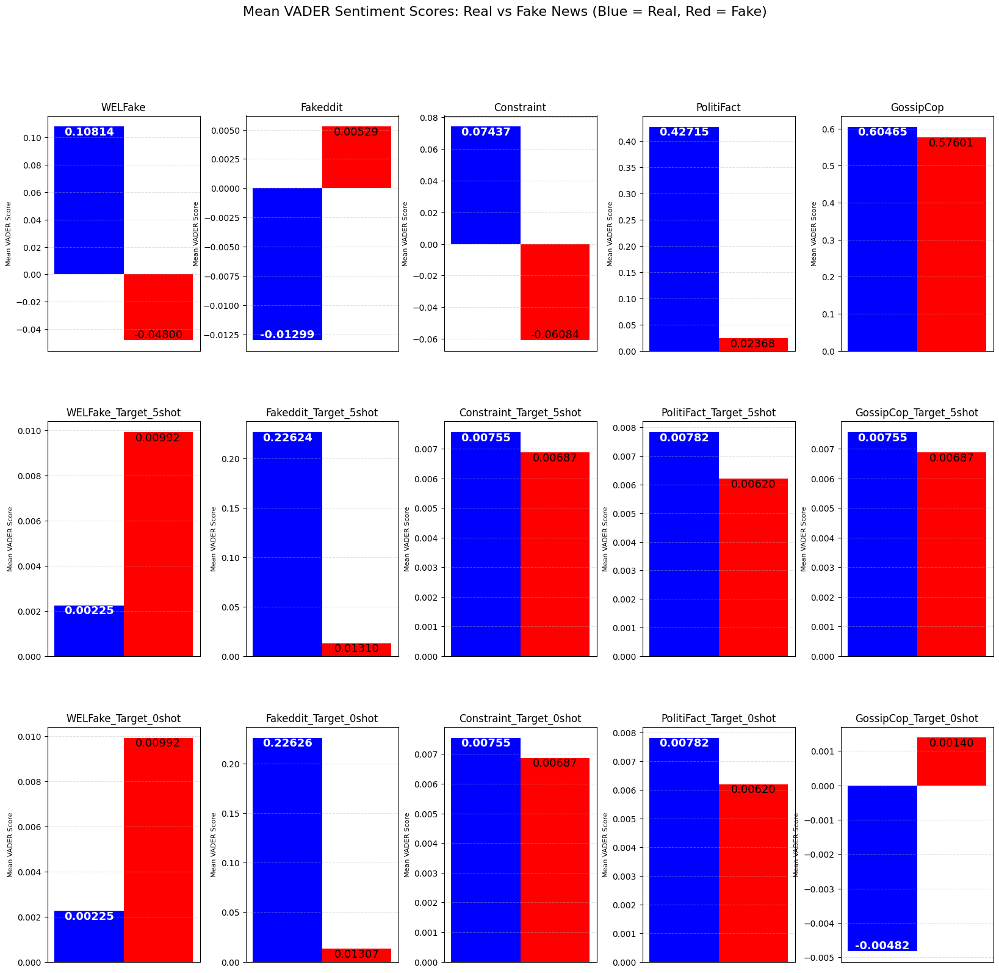

In [26]:
sent_feat_analyzer.plotMeanVADERScoresRealVsFakeNewsSideBySide(vader_scores_concat_df)

#### Interpreting the Main Trends in VADER Sentiment Scores

- For WELFake, Fakeddit and Constraint, the mean sentiment scores are close to 0, showing that these texts had about average sentiment polarity (neither positive or negative emotions)
- For PolitiFact, the compound sentiment polarity was an important distinguishing feature between real and fake news, as real news has a significantly more positive tone overall, while the mean fake news sentiment polarity was close to 0 (neutral polarity).
- For both the fake and real news sets, the entertainment-focused GossipCop dataset had more positive mean sentiment scores.
- For all datasets except for Fakeddit (the majority class in the mixed datasets), real news was more positive in tone on average compared to fake news

### Calculating NRC Lexicon Emotion Scores for Real vs Fake News Texts

As the VADER results were not too promising, we can apply a more fine-grained approach using the NRC Emotion Lexicon to extract normalized frequencies for each of 10 emotions per text instead, which uses the following list of emotions: ["anger", "anticipation", "disgust", "fear", "joy", "negative", "positive", "sadness", "surprise", "trust"].

Hopefully, this will yield more consistent results across the datasets.

In [27]:
# Full-scale datasets: processing the datasets to extract NRC emotion scores

# WELFake dataset
wf_real_emoscores_df, wf_real_mean_emoscores_dict, wf_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    wf_df_real, "WELFake_Real"
)
wf_fake_emoscores_df, wf_fake_mean_emoscores_dict, wf_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    wf_df_fake, "WELFake_Fake"
)

# Fakeddit dataset
fe_real_emoscores_df, fe_real_mean_emoscores_dict, fe_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    fe_df_real, "Fakeddit_Real"
)
fe_fake_emoscores_df, fe_fake_mean_emoscores_dict, fe_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    fe_df_fake, "Fakeddit_Fake"
)

# Constraint dataset
ct_real_emoscores_df, ct_real_mean_emoscores_dict, ct_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    ct_df_real, "Constraint_Real"
)
ct_fake_emoscores_df, ct_fake_mean_emoscores_dict, ct_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    ct_df_fake, "Constraint_Fake"
)

# PolitiFact dataset
pf_real_emoscores_df, pf_real_mean_emoscores_dict, pf_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
   pf_df_real, "PolitiFact_Real"
)
pf_fake_emoscores_df, pf_fake_mean_emoscores_dict, pf_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    pf_df_fake, "PolitiFact_Fake"
)

# GossipCop dataset
gc_real_emoscores_df, gc_real_mean_emoscores_dict, gc_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    gc_df_real, "GossipCop_Real"
)
gc_fake_emoscores_df, gc_fake_mean_emoscores_dict, gc_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    gc_df_fake, "GossipCop_Fake"
)












rocessing NRC Lexicon emotion scores for GossipCop_Fake...: 100%|█| 4020/4020 [

In [28]:
# Five-shot datasets: processing to get NRC emotion scores

# Target: WELFake five-shot dataset
wf_5shot_real_emoscores_df, wf_5shot_real_mean_emoscores_dict, wf_5shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    wf_tgt_5shot_df_real, "WELFake_Target_5shot_Real"
)
wf_5shot_fake_emoscores_df, wf_5shot_fake_mean_emoscores_dict, wf_5shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    wf_tgt_5shot_df_fake, "WELFake_Target_5shot_Fake"
)

# Fakeddit five-shot dataset
fe_5shot_real_emoscores_df, fe_5shot_real_mean_emoscores_dict, fe_5shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    fe_tgt_5shot_df_real, "Fakeddit_5shot_Real"
)
fe_5shot_fake_emoscores_df, fe_5shot_fake_mean_emoscores_dict, fe_5shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    fe_tgt_5shot_df_fake, "Fakeddit_5shot_Fake"
)

# Constraint five-shot dataset
ct_5shot_real_emoscores_df, ct_5shot_real_mean_emoscores_dict, ct_5shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    ct_tgt_5shot_df_real, "Constraint_5shot_Real"
)
ct_5shot_fake_emoscores_df, ct_5shot_fake_mean_emoscores_dict, ct_5shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    ct_tgt_5shot_df_fake, "Constraint_5shot_Fake"
)

# PolitiFact five-shot dataset
pf_5shot_real_emoscores_df, pf_5shot_real_mean_emoscores_dict, pf_5shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    pf_tgt_5shot_df_real, "PolitiFact_5shot_Real"
)
pf_5shot_fake_emoscores_df, pf_5shot_fake_mean_emoscores_dict, pf_5shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    pf_tgt_5shot_df_fake, "PolitiFact_5shot_Fake"
)

# GossipCop five-shot dataset
gc_5shot_real_emoscores_df, gc_5shot_real_mean_emoscores_dict, gc_5shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    gc_tgt_5shot_df_real, "GossipCop_5shot_Real"
)
gc_5shot_fake_emoscores_df, gc_5shot_fake_mean_emoscores_dict, gc_5shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    gc_tgt_5shot_df_fake, "GossipCop_5shot_Fake"
)











rocessing NRC Lexicon emotion scores for GossipCop_5shot_Fake...: 100%|█| 30856

In [29]:
# Zero-shot datasets: processing to get NRC emotion scores

# Target: WELFake zero-shot dataset
wf_0shot_real_emoscores_df, wf_0shot_real_mean_emoscores_dict, wf_0shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    wf_tgt_0shot_df_real, "WELFake_Target_0shot_Real"
)
wf_0shot_fake_emoscores_df, wf_0shot_fake_mean_emoscores_dict, wf_0shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    wf_tgt_0shot_df_fake, "WELFake_Target_0shot_Fake"
)

# Target: Fakeddit zero-shot dataset
fe_0shot_real_emoscores_df, fe_0shot_real_mean_emoscores_dict, fe_0shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    fe_tgt_0shot_df_real, "Fakeddit_Target_0shot_Real"
)
fe_0shot_fake_emoscores_df, fe_0shot_fake_mean_emoscores_dict, fe_0shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    fe_tgt_0shot_df_fake, "Fakeddit_Target_0shot_Fake"
)

# Target: Constraint zero-shot dataset
ct_0shot_real_emoscores_df, ct_0shot_real_mean_emoscores_dict, ct_0shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    ct_tgt_0shot_df_real, "Constraint_Target_0shot_Real"
)
ct_0shot_fake_emoscores_df, ct_0shot_fake_mean_emoscores_dict, ct_0shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    ct_tgt_0shot_df_fake, "Constraint_Target_0shot_Fake"
)

# Target: PolitiFact zero-shot dataset
pf_0shot_real_emoscores_df, pf_0shot_real_mean_emoscores_dict, pf_0shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    pf_tgt_0shot_df_real, "PolitiFact_Target_0shot_Real"
)
pf_0shot_fake_emoscores_df, pf_0shot_fake_mean_emoscores_dict, pf_0shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    pf_tgt_0shot_df_fake, "PolitiFact_Target_0shot_Fake"
)

# Target: GossipCop zero-shot dataset
gc_0shot_real_emoscores_df, gc_0shot_real_mean_emoscores_dict, gc_0shot_real_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    gc_tgt_0shot_df_real, "GossipCop_Target_0shot_Real"
)
gc_0shot_fake_emoscores_df, gc_0shot_fake_mean_emoscores_dict, gc_0shot_fake_mean_emoscores_df = sent_feat_analyzer.calculateNRCEmotionLexiconScores(
    gc_tgt_0shot_df_fake, "GossipCop_Target_0shot_Fake"
)











rocessing NRC Lexicon emotion scores for GossipCop_Target_0shot_Fake...: 100%|█

In [35]:
# Concatenates the DataFrames for plotting
nrc_emo_mean_scores_concat_df_list = [
    wf_real_mean_emoscores_df, wf_fake_mean_emoscores_df,
    fe_real_mean_emoscores_df, fe_fake_mean_emoscores_df,
    ct_real_mean_emoscores_df, ct_fake_mean_emoscores_df,
    pf_real_mean_emoscores_df, pf_fake_mean_emoscores_df,
    gc_real_mean_emoscores_df, gc_fake_mean_emoscores_df,
    wf_5shot_real_mean_emoscores_df, wf_5shot_fake_mean_emoscores_df,
    fe_5shot_real_mean_emoscores_df, fe_5shot_fake_mean_emoscores_df,
    ct_5shot_real_mean_emoscores_df, ct_5shot_fake_mean_emoscores_df,
    pf_5shot_real_mean_emoscores_df, pf_5shot_fake_mean_emoscores_df,
    gc_5shot_real_mean_emoscores_df, gc_5shot_fake_mean_emoscores_df,
    wf_0shot_real_mean_emoscores_df, wf_0shot_fake_mean_emoscores_df,
    fe_0shot_real_mean_emoscores_df, fe_0shot_fake_mean_emoscores_df,
    ct_0shot_real_mean_emoscores_df, ct_0shot_fake_mean_emoscores_df,
    pf_0shot_real_mean_emoscores_df, pf_0shot_fake_mean_emoscores_df,
    gc_0shot_real_mean_emoscores_df, gc_0shot_fake_mean_emoscores_df,
]

nrc_emo_mean_scores_concat_df = pd.concat(nrc_emo_mean_scores_concat_df_list)

# Displays the first few lines of the combined DataFrame
nrc_emo_mean_scores_concat_df.head(5)

,anger,anticipation,disgust,fear,joy,negative,positive,sadness,surprise,trust
WELFake_Real,0.070931,0.094333,0.029318,0.099638,0.055039,0.150914,0.229927,0.062901,0.037424,0.168562
WELFake_Fake,0.077902,0.089752,0.043251,0.095940,0.060422,0.158620,0.209737,0.066770,0.039013,0.142232
Fakeddit_Real,0.031769,0.049905,0.022129,0.052094,0.041764,0.090631,0.125963,0.030690,0.022025,0.074813
Fakeddit_Fake,0.026026,0.049485,0.017612,0.038438,0.032376,0.073084,0.097655,0.023785,0.019611,0.052388
Constraint_Real,0.020208,0.107856,0.014816,0.075683,0.027370,0.130639,0.255817,0.063359,0.022185,0.126002


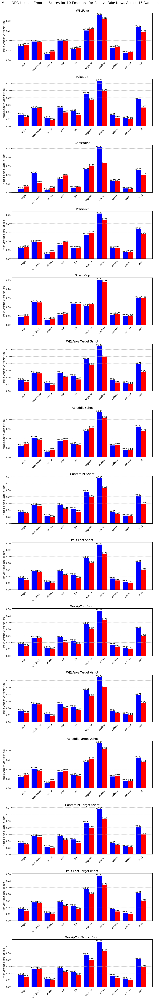

In [36]:
sent_feat_analyzer.plotMeanNRCEmotionLexiconScoresRealVsFakeNewsSideBySide(nrc_emo_mean_scores_concat_df)

#### Interpretation of Main Tendencies in NRC Emotion Scores Across All the Datasets

- Overall, real news was associated with higher scores for "trust" than fake news, which is what would be expected, as fake news and propaganda tends to stir up distrust in organizations and institutions.
- Much higher "positive" sentiment scores in real news texts than in fake news texts. This is in contrast to the results obtained with the VADER lexicon, which shows that the NRC lexicon has more potential for building a generalizable classifier. However, negativity scores were inconsistent.
- Slightly higher scores for anger in fake news than real news with the exception of the Fakeddit dataset.
- No clear trends in the difference between anticipation, disgust, sadness or surprise scores in real and fake news across the datasets.


### Extracting Valence, Arousal, Dominance Sentiment Scores for Real vs Fake News for All Datasets

In [45]:
# Extracts scores for full-scale datasets

# WELFake
wf_real_vadscores_df, wf_real_mean_vadscores_dict, wf_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    wf_df_real, "WELFake_Real", stopwords_set)
wf_fake_vadscores_df, wf_fake_mean_vadscores_dict, wf_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    wf_df_fake, "WELFake_Fake", stopwords_set)

# Fakeddit
fe_real_vadscores_df, fe_real_mean_vadscores_dict, fe_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    fe_df_real, "Fakeddit_Real", stopwords_set)
fe_fake_vadscores_df, fe_fake_mean_vadscores_dict, fe_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    fe_df_fake, "Fakeddit_Fake", stopwords_set)

# Constraint
ct_real_vadscores_df, ct_real_mean_vadscores_dict, ct_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    ct_df_real, "Constraint_Real", stopwords_set)
ct_fake_vadscores_df, ct_fake_mean_vadscores_dict, ct_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    ct_df_fake, "Constraint_Fake", stopwords_set)

# PolitiFact
pf_real_vadscores_df, pf_real_mean_vadscores_dict, pf_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    pf_df_real, "PolitiFact_Real", stopwords_set)
pf_fake_vadscores_df, pf_fake_mean_vadscores_dict, pf_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    pf_df_fake, "PolitiFact_Fake", stopwords_set)

# GossipCop
gc_real_vadscores_df, gc_real_mean_vadscores_dict, gc_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    gc_df_real, "GossipCop_Real", stopwords_set)
gc_fake_vadscores_df, gc_fake_mean_vadscores_dict, gc_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    gc_df_fake, "GossipCop_Fake", stopwords_set)












rocessing VAD scores for GossipCop_Fake...: 100%|█| 4020/4020 [00:06<00:00, 643

In [46]:
# Extracts scores for five-shot datasets

# Target: WELFake
wf_5shot_real_vadscores_df, wf_5shot_real_mean_vadscores_dict, wf_5shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    wf_tgt_5shot_df_real, "WELFake_Target_5shot_Real", stopwords_set)
wf_5shot_fake_vadscores_df, wf_5shot_fake_mean_vadscores_dict, wf_5shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    wf_tgt_5shot_df_fake, "WELFake_Target_5shot_Fake", stopwords_set)

# Target: Fakeddit
fe_5shot_real_vadscores_df, fe_5shot_real_mean_vadscores_dict, fe_5shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    fe_tgt_5shot_df_real, "Fakeddit_Target_5shot_Real", stopwords_set)
fe_5shot_fake_vadscores_df, fe_5shot_fake_mean_vadscores_dict, fe_5shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    fe_tgt_5shot_df_fake, "Fakeddit_Target_5shot_Fake", stopwords_set)

# Target: Constraint
ct_5shot_real_vadscores_df, ct_5shot_real_mean_vadscores_dict, ct_5shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    ct_tgt_5shot_df_real, "Constraint_Target_5shot_Real", stopwords_set)
ct_5shot_fake_vadscores_df, ct_5shot_fake_mean_vadscores_dict, ct_5shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    ct_tgt_5shot_df_fake, "Constraint_Target_5shot_Fake", stopwords_set)

# Target: PolitiFact
pf_5shot_real_vadscores_df, pf_5shot_real_mean_vadscores_dict, pf_5shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    pf_tgt_5shot_df_real, "PolitiFact_Target_5shot_Real", stopwords_set)
pf_5shot_fake_vadscores_df, pf_5shot_fake_mean_vadscores_dict, pf_5shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    pf_tgt_5shot_df_fake, "PolitiFact_Target_5shot_Fake", stopwords_set)

# Target: GossipCop
gc_5shot_real_vadscores_df, gc_5shot_real_mean_vadscores_dict, gc_5shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    gc_tgt_5shot_df_real, "GossipCop_Target_5shot_Real", stopwords_set)
gc_5shot_fake_vadscores_df, gc_5shot_fake_mean_vadscores_dict, gc_5shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    gc_tgt_5shot_df_fake, "GossipCop_Target_5shot_Fake", stopwords_set)











rocessing VAD scores for GossipCop_Target_5shot_Fake...: 100%|█| 308561/308561 

In [47]:
# Extracts scores for zero-shot datasets

# Target: WELFake
wf_0shot_real_vadscores_df, wf_0shot_real_mean_vadscores_dict, wf_0shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    wf_tgt_0shot_df_real, "WELFake_Target_0shot_Real", stopwords_set)
wf_0shot_fake_vadscores_df, wf_0shot_fake_mean_vadscores_dict, wf_0shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    wf_tgt_0shot_df_fake, "WELFake_Target_0shot_Fake", stopwords_set)

# Target: Fakeddit
fe_0shot_real_vadscores_df, fe_0shot_real_mean_vadscores_dict, fe_0shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    fe_tgt_0shot_df_real, "Fakeddit_Target_0shot_Real", stopwords_set)
fe_0shot_fake_vadscores_df, fe_0shot_fake_mean_vadscores_dict, fe_0shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    fe_tgt_0shot_df_fake, "Fakeddit_Target_0shot_Fake", stopwords_set)

# Target: Constraint
ct_0shot_real_vadscores_df, ct_0shot_real_mean_vadscores_dict, ct_0shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    ct_tgt_0shot_df_real, "Constraint_Target_0shot_Real", stopwords_set)
ct_0shot_fake_vadscores_df, ct_0shot_fake_mean_vadscores_dict, ct_0shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    ct_tgt_0shot_df_fake, "Constraint_Target_0shot_Fake", stopwords_set)

# Target: PolitiFact
pf_0shot_real_vadscores_df, pf_0shot_real_mean_vadscores_dict, pf_0shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    pf_tgt_0shot_df_real, "PolitiFact_Target_0shot_Real", stopwords_set)
pf_0shot_fake_vadscores_df, pf_0shot_fake_mean_vadscores_dict, pf_0shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    pf_tgt_0shot_df_fake, "PolitiFact_Target_0shot_Fake", stopwords_set)

# Target: GossipCop
gc_0shot_real_vadscores_df, gc_0shot_real_mean_vadscores_dict, gc_0shot_real_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    gc_tgt_0shot_df_real, "GossipCop_Target_0shot_Real", stopwords_set)
gc_0shot_fake_vadscores_df, gc_0shot_fake_mean_vadscores_dict, gc_0shot_fake_mean_vadscores_df = sent_feat_analyzer.calculateVADEmotionLexiconScores(
    gc_tgt_0shot_df_fake, "GossipCop_Target_0shot_Fake", stopwords_set)











rocessing VAD scores for GossipCop_Target_0shot_Fake...: 100%|█| 309031/309031 

In [51]:
# Concatenates the mean average VAD-score DFs

list_of_mean_vad_score_dfs = [
    wf_real_mean_vadscores_df, wf_fake_mean_vadscores_df,
    fe_real_mean_vadscores_df, fe_fake_mean_vadscores_df,
    ct_real_mean_vadscores_df, ct_fake_mean_vadscores_df,
    pf_real_mean_vadscores_df, pf_fake_mean_vadscores_df,
    gc_real_mean_vadscores_df, gc_fake_mean_vadscores_df,
    wf_5shot_real_mean_vadscores_df, wf_5shot_fake_mean_vadscores_df,
    fe_5shot_real_mean_vadscores_df, fe_5shot_fake_mean_vadscores_df,
    ct_5shot_real_mean_vadscores_df, ct_5shot_fake_mean_vadscores_df,
    pf_5shot_real_mean_vadscores_df, pf_5shot_fake_mean_vadscores_df,
    gc_5shot_real_mean_vadscores_df, gc_5shot_fake_mean_vadscores_df,
    wf_0shot_real_mean_vadscores_df, wf_0shot_fake_mean_vadscores_df,
    fe_0shot_real_mean_vadscores_df, fe_0shot_fake_mean_vadscores_df,
    ct_0shot_real_mean_vadscores_df, ct_0shot_fake_mean_vadscores_df,
    pf_0shot_real_mean_vadscores_df, pf_0shot_fake_mean_vadscores_df,
    gc_0shot_real_mean_vadscores_df, gc_0shot_fake_mean_vadscores_df
]

mean_vad_score_concat_dfs = pd.concat(list_of_mean_vad_score_dfs)

In [52]:
mean_vad_score_concat_dfs.head(10)

,valence,arousal,dominance
WELFake_Real,0.583610,0.480336,0.594010
WELFake_Fake,0.579228,0.483231,0.574124
Fakeddit_Real,0.574745,0.451760,0.499182
Fakeddit_Fake,0.550037,0.446857,0.494828
Constraint_Real,0.603669,0.435373,0.551143
Constraint_Fake,0.548172,0.477169,0.542254
PolitiFact_Real,0.599161,0.465198,0.584989
PolitiFact_Fake,0.586564,0.477966,0.573534
GossipCop_Real,0.638025,0.465250,0.541942
GossipCop_Fake,0.630956,0.469558,0.543507


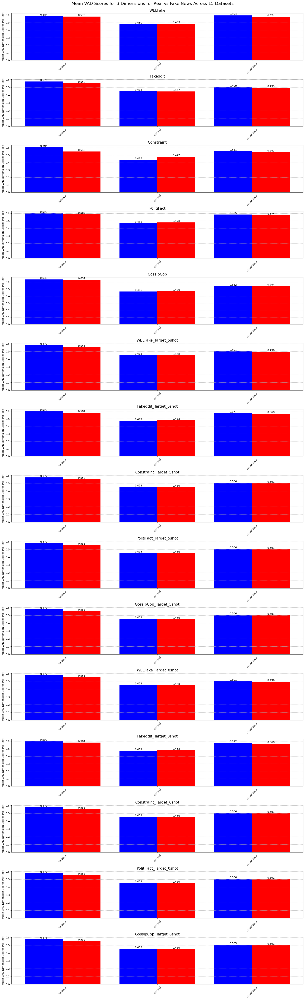

In [53]:
sent_feat_analyzer.plotMeanVADEmotionScoresRealVsFakeNewsSideBySide(mean_vad_score_concat_dfs)

#### Interpretation of Main Tendencies in VAD Emotion Scores Across All the Datasets

- Overall, the differences in the scores for real vs fake news are very small for all the five core datasets.
- Valence (positivity or negativity of affect) is slightly higher for real news than for fake news across all datasets.
- Hardly any difference in the "arousal" scores (how intense the emotion is) or the "dominance" scores (how much the emotion communicates control vs passivity) between real and fake news, which is surprising, as I would have expected that fake news had higher dominance scores due to containing more aggressive and dramatic content.
- Scores for these last two dimensions are around 0.5 for all dataset, signally than on average, arousal and dominance are neutral across both the real-fake splits.

### Extracting Subjectivity Scores for Real vs Fake News for All Datasets

The TextBlob library offers functionality for evaluating the subjectivity or objectivity of a text numerically, and outputting a score between 0.0 (completely objective) and 1.0 (completely subjective) for a news text. This might also be able to capture some patterns for distinguishing between real and fake news across the datasets.

In [54]:
# Processes full-scale DataFrames with TextBlob Subjectivity Scores

# Calculates the mean TextBlob subjectivity scores for the WELFake dataset
wf_real_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(wf_df_real, "WELFake_Real")
wf_fake_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(wf_df_fake, "WELFake_Fake")

# Calculates the mean TextBlob subjectivity scores for the Fakeddit dataset
fe_real_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(fe_df_real, "Fakeddit_Real")
fe_fake_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(fe_df_fake, "Fakeddit_Fake")

# Calculates the mean TextBlob subjectivity scores for the Constraint dataset
ct_real_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(ct_df_real, "Constraint_Real")
ct_fake_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(ct_df_fake, "Constraint_Fake")

# Calculates the mean TextBlob subjectivity scores for the PolitiFact dataset
pf_real_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(pf_df_real, "PolitiFact_Real")
pf_fake_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(pf_df_fake, "PolitiFact_Fake")

# Calculates the mean TextBlob subjectivity scores for the GossipCop dataset
gc_real_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(gc_df_real, "GossipCop_Real")
gc_fake_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(gc_df_fake, "GossipCop_Fake")

Extracting Subjectivity Scores for WELFake_Real...



00%|████████████████████████████████████| 34617/34617 [00:40<00:00, 862.46it/s]

Extracting Subjectivity Scores for WELFake_Fake...



00%|███████████████████████████████████| 27505/27505 [00:25<00:00, 1061.41it/s]

Extracting Subjectivity Scores for Fakeddit_Real...



00%|████████████████████████████████| 440869/440869 [00:22<00:00, 19238.24it/s]

Extracting Subjectivity Scores for Fakeddit_Fake...



00%|████████████████████████████████| 348634/348634 [00:17<00:00, 19838.36it/s]

Extracting Subjectivity Scores for Constraint_Real...



00%|█████████████████████████████████████| 5581/5581 [00:00<00:00, 9557.83it/s]

Extracting Subjectivity Scores for Constraint_Fake...



00%|████████████████████████████████████| 5045/5045 [00:00<00:00, 12935.90it/s]

Extracting Subjectivity Scores for PolitiFact_Real...



00%|████████████████████████████████████████| 349/349 [00:01<00:00, 217.81it/s]

Extracting Subjectivity Scores for PolitiFact_Fake...



00%|███████████████████████████████████████| 317/317 [00:00<00:00, 1183.71it/s]

Extracting Subjectivity Scores for GossipCop_Real...



00%|████████████████████████████████████| 13153/13153 [00:16<00:00, 774.29it/s]

Extracting Subjectivity Scores for GossipCop_Fake...



00%|██████████████████████████████████████| 4020/4020 [00:04<00:00, 835.64it/s]

In [57]:
# Processes five-shot DataFrames with TextBlob Subjectivity Scores

# Calculates the mean TextBlob subjectivity scores for the 5-shot Target: WELFake dataset
wf_real_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(wf_tgt_5shot_df_real, "WELFake_Target_5shot_Real")
wf_fake_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(wf_tgt_5shot_df_fake, "WELFake_Target_5shot_Fake")

# Calculates the mean TextBlob subjectivity scores for the 5-shot Target: Fakeddit dataset
fe_real_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(fe_tgt_5shot_df_real, "Fakeddit_Target_5shot_Real")
fe_fake_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(fe_tgt_5shot_df_fake, "Fakeddit_Target_5shot_Fake")

# Calculates the mean TextBlob subjectivity scores for the 5-shot Target: Constraint dataset
ct_real_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(ct_tgt_5shot_df_real, "Constraint_Target_5shot_Real")
ct_fake_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(ct_tgt_5shot_df_fake, "Constraint_Target_5shot_Fake")

# Calculates the mean TextBlob subjectivity scores for the 5-shot Target: PolitiFact dataset
pf_real_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(pf_tgt_5shot_df_real, "PolitiFact_Target_5shot_Real")
pf_fake_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(pf_tgt_5shot_df_fake, "PolitiFact_Target_5shot_Fake")

# Calculates the mean TextBlob subjectivity scores for the 5-shot Target: GossipCop dataset
gc_real_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(gc_tgt_5shot_df_real, "GossipCop_Target_5shot_Real")
gc_fake_5shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(gc_tgt_5shot_df_fake, "GossipCop_Target_5shot_Fake")

Extracting Subjectivity Scores for WELFake_Target_5shot_Real...



00%|████████████████████████████████| 373728/373728 [00:31<00:00, 11980.76it/s]

Extracting Subjectivity Scores for WELFake_Target_5shot_Fake...



00%|████████████████████████████████| 292205/292205 [00:18<00:00, 16231.47it/s]

Extracting Subjectivity Scores for Fakeddit_Target_5shot_Real...



00%|████████████████████████████████████| 34243/34243 [00:39<00:00, 876.68it/s]

Extracting Subjectivity Scores for Fakeddit_Target_5shot_Fake...



00%|███████████████████████████████████| 25174/25174 [00:21<00:00, 1144.95it/s]

Extracting Subjectivity Scores for Constraint_Target_5shot_Real...



00%|█████████████████████████████████| 392556/392556 [00:57<00:00, 6847.26it/s]

Extracting Subjectivity Scores for Constraint_Target_5shot_Fake...



00%|█████████████████████████████████| 308561/308561 [00:36<00:00, 8465.37it/s]

Extracting Subjectivity Scores for PolitiFact_Target_5shot_Real...



00%|█████████████████████████████████| 395677/395677 [00:56<00:00, 7029.02it/s]

Extracting Subjectivity Scores for PolitiFact_Target_5shot_Fake...



00%|█████████████████████████████████| 311382/311382 [00:35<00:00, 8672.10it/s]

Extracting Subjectivity Scores for GossipCop_Target_5shot_Real...



00%|█████████████████████████████████| 392556/392556 [00:58<00:00, 6762.94it/s]

Extracting Subjectivity Scores for GossipCop_Target_5shot_Fake...



00%|█████████████████████████████████| 308561/308561 [00:36<00:00, 8395.02it/s]

In [58]:
# Process Zero-Shot DFs with TextBlob Subjectivity Scores

# Calculates the mean TextBlob subjectivity scores for the 0-shot Target: WELFake dataset
wf_real_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(wf_tgt_0shot_df_real, "WELFake_Target_0shot_Real")
wf_fake_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(wf_tgt_0shot_df_fake, "WELFake_Target_0shot_Fake")

# Calculates the mean TextBlob subjectivity scores for the 0-shot Target: Fakeddit dataset
fe_real_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(fe_tgt_0shot_df_real, "Fakeddit_Target_0shot_Real")
fe_fake_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(fe_tgt_0shot_df_fake, "Fakeddit_Target_0shot_Fake")

# Calculates the mean TextBlob subjectivity scores for the 0-shot Target: Constraint dataset
ct_real_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(ct_tgt_0shot_df_real, "Constraint_Target_0shot_Real")
ct_fake_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(ct_tgt_0shot_df_fake, "Constraint_Target_0shot_Fake")

# Calculates the mean TextBlob subjectivity scores for the 0-shot Target: PolitiFact dataset
pf_real_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(pf_tgt_0shot_df_real, "PolitiFact_Target_0shot_Real")
pf_fake_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(pf_tgt_0shot_df_fake, "PolitiFact_Target_0shot_Fake")

# Calculates the mean TextBlob subjectivity scores for the 0-shot Target: GossipCop dataset
gc_real_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(gc_tgt_0shot_df_real, "GossipCop_Target_0shot_Real")
gc_fake_0shot_subj_df = sent_feat_analyzer.calculateTextBlobSubjectivityScores(gc_tgt_0shot_df_fake, "GossipCop_Target_0shot_Fake")

Extracting Subjectivity Scores for WELFake_Target_0shot_Real...



00%|████████████████████████████████| 373723/373723 [00:31<00:00, 11770.71it/s]

Extracting Subjectivity Scores for WELFake_Target_0shot_Fake...



00%|████████████████████████████████| 292205/292205 [00:18<00:00, 16202.57it/s]

Extracting Subjectivity Scores for Fakeddit_Target_0shot_Real...



00%|████████████████████████████████████| 34241/34241 [00:38<00:00, 882.62it/s]

Extracting Subjectivity Scores for Fakeddit_Target_0shot_Fake...



00%|███████████████████████████████████| 25171/25171 [00:21<00:00, 1165.41it/s]

Extracting Subjectivity Scores for Constraint_Target_0shot_Real...



00%|█████████████████████████████████| 392551/392551 [00:56<00:00, 6999.30it/s]

Extracting Subjectivity Scores for Constraint_Target_0shot_Fake...



00%|█████████████████████████████████| 308561/308561 [00:36<00:00, 8462.48it/s]

Extracting Subjectivity Scores for PolitiFact_Target_0shot_Real...



00%|█████████████████████████████████| 395673/395673 [00:56<00:00, 6948.59it/s]

Extracting Subjectivity Scores for PolitiFact_Target_0shot_Fake...



00%|█████████████████████████████████| 311381/311381 [00:36<00:00, 8474.68it/s]

Extracting Subjectivity Scores for GossipCop_Target_0shot_Real...



00%|█████████████████████████████████| 387417/387417 [00:46<00:00, 8243.57it/s]

Extracting Subjectivity Scores for GossipCop_Target_0shot_Fake...



00%|█████████████████████████████████| 309031/309031 [00:33<00:00, 9237.09it/s]

In [59]:
# Concatenate the mean subjectivity score DFs into a single DF for plotting a grid

# Create list to concatenate
subj_df_list = [
    wf_real_subj_df, wf_fake_subj_df, 
    fe_real_subj_df, fe_fake_subj_df,
    ct_real_subj_df, ct_fake_subj_df,
    pf_real_subj_df, pf_fake_subj_df,
    gc_real_subj_df, gc_fake_subj_df,
    wf_real_5shot_subj_df, wf_fake_5shot_subj_df,
    fe_real_5shot_subj_df, fe_fake_5shot_subj_df,
    ct_real_5shot_subj_df, ct_fake_5shot_subj_df,
    pf_real_5shot_subj_df, pf_fake_5shot_subj_df,
    gc_real_5shot_subj_df, gc_fake_5shot_subj_df,
    wf_real_0shot_subj_df, wf_fake_0shot_subj_df,
    fe_real_0shot_subj_df, fe_fake_0shot_subj_df,
    ct_real_0shot_subj_df, ct_fake_0shot_subj_df,
    pf_real_0shot_subj_df, pf_fake_0shot_subj_df,
    gc_real_0shot_subj_df, gc_fake_0shot_subj_df
]

# Concatenate the list of dataframes; index will be dataset name
subj_concat_df = pd.concat(subj_df_list)

subj_concat_df.head()

,mean_subjectivity_score
dataset_name,
WELFake_Real,0.382727
WELFake_Fake,0.445882
Fakeddit_Real,0.221870
Fakeddit_Fake,0.260103
Constraint_Real,0.425232


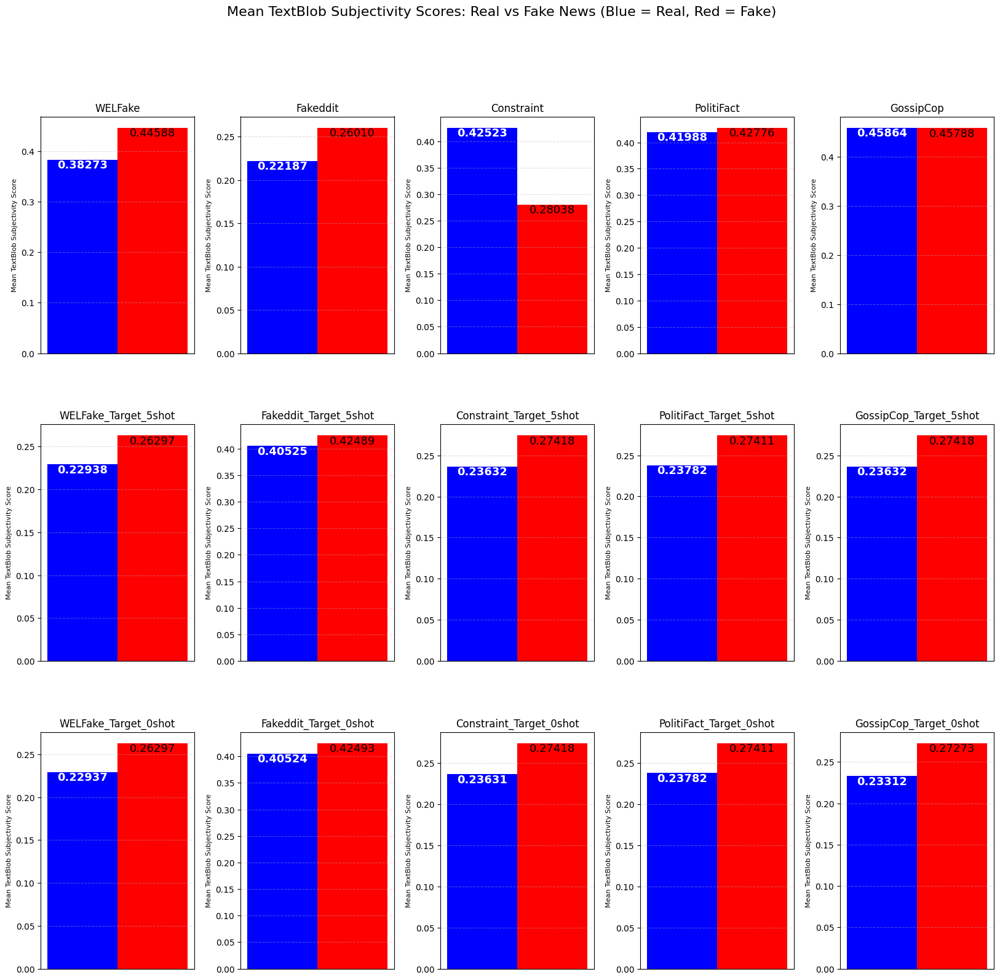

In [60]:
# Plot the real vs fake scores in a grid
sent_feat_analyzer.plotMeanTextBlobSubjectivityScores(subj_concat_df)

Overall, as expected, fake news received a higher subjectivity score on average compared to real news, with the exception of the Constraint dataset, where mean subjectivity was much higher for real news (0.43) than fake news (0.28). This could be attributed to the authors of COVID-19 based disinformation applying a domain-specific strategy to make the news seem more scientific and factual.

## 2. Analyzing Language Quality Patterns in Fake vs Real News

In this section, I will look at how scores for toxic language (e.g. swearing, insulting terms) and misspellings vary between fake and real news for the datasets.

In [30]:
class LanguageQualityFeatureAnalyzer:
    
    def __init__(self):
        # Reference: toxic language lexicon -> https://github.com/Orthrus-Lexicon/Toxic
        
        # Loads in the toxic words from the downloaded .txt file
        self.toxic_path = "./toxic_words.txt"
        
        # Detects the file encoding, as the toxic lexicon is NOT utf-8 and throws error. Detected it  with the chardet library
        # Reference (character encoding auto detection in Python): https://chardet.readthedocs.io/en/latest/
        with open(self.toxic_path, "rb") as raw_text_file:
            # Detects the binary file's character encoding
            chardet_encoding = chardet.detect(raw_text_file.read())
            # Extracts the character encoding
            text_encoding = chardet_encoding["encoding"]
            # Prints what it was
            print(f"The toxic_words.txt file encoding has been detected as: {text_encoding}")

        # Now uses this detected encoding to open the .txt file as normal in read mode
        with open(self.toxic_path, "r", encoding=text_encoding) as toxic_words_file:
            # Strips the whitespace and extract each toxic word from each line, store them in Python list
            self.toxic_words = [line.strip() for line in toxic_words_file]
            print(f"Loaded in {len(self.toxic_words)} toxic words. First ten words: {self.toxic_words[:10]}")

    def calculateMeanScoresForToxicWordFrequencies(self, df, dataset_name):
        """
        Calculates toxic-term frequencies for each text, normalized by text length (in tokens), and returns
        a DataFrame containing the mean normalized toxic-term frequency for the texts in this dataset,
        with the dataset_name as the index
        
        Input Parameters:
            df (pd.DataFrame): The DataFrame containing the texts for the analysis.
            dataset_name (str): The name of the dataset for the Index of the new averages dict.
        
        Output:
            pd.DataFrame: A DataFrame containing the mean, normalized, toxic word frequencies for the input dataset.
        """

        # Creates a copy of original dataset
        toxic_df = df.copy()

        # Creates a new column in the DataFrame to store the toxic word frequency for this dataset in, initialize to 0.0
        toxic_df["norm_toxic_word_freq"] = 0.0

        # Creates tqdm progress bar to monitor progress
        total_rows = len(toxic_df)
        with tqdm(total=total_rows, desc=f"Calculating toxic-word frequencies for {dataset_name}", 
                 position=0, leave=True, ncols=100) as progress_bar:
            # Loops through DataFram rows
            for idx, row in toxic_df.iterrows():
                # Extracts text column value
                text = row["text"]
                # Tokenizes text into words to get the text length for normalization
                word_tokens = word_tokenize(text)
                text_length = len(word_tokens)
    
                # Skips this if text length is zero, to avoid division by zero
                if text_length == 0:
                    toxic_df.at[idx, "norm_toxic_word_freq"] = 0.0
                    progress_bar.update(1)
                    continue
    
                # Uses the sum function to calculate toxic word frequency
                toxic_word_frequency_for_row = sum(1 for word in word_tokens if word in self.toxic_words)
                
                # Normalizes the toxic word frequency by text length
                normalized_toxic_word_frequency_for_row = toxic_word_frequency_for_row / text_length
                
                # Adds the normalized frequency to the new column
                toxic_df.at[idx, "norm_toxic_word_freq"] = normalized_toxic_word_frequency_for_row
    
                progress_bar.update(1)
    
        # Calculates the mean normalized toxic word frequency
        mean_toxic_frequency = toxic_df["norm_toxic_word_freq"].mean()
    
        # Returns the result as a DataFrame with the dataset_name as the index for later concatenation with other datasets
        mean_toxic_frequency_df = pd.DataFrame(
            {"mean_normalized_toxic_word_frequency": [mean_toxic_frequency]},
            index=[dataset_name]
        )
    
        return mean_toxic_frequency_df

    def calculateMeanScoresForMisspelledWordFrequencies(self, df, dataset_name):
        """
        Calculates misspelled word frequencies for each text, normalized by text length (in tokens), and returns
        a DataFrame containing the mean normalized misspelling frequency for the texts in this dataset,
        with the dataset_name as the index
        
        Input Parameters:
        df (pd.DataFrame): The DataFrame containing the texts for the analysis.
        dataset_name (str): The name of the dataset for the Index of the new averages dict.
        
        Returns:
        pd.DataFrame: A DataFrame containing the mean normalized misspelling frequency for the input dataset.
        """
        
        # Instantiates the spell checker from Reference: https://pypi.org/project/pyspellchecker/
        spell = SpellChecker()
        misspelled_df = df.copy()
        
        # Creates a new DataFrame column for the misspelled word frequency
        misspelled_df["norm_misspelled_word_freq"] = 0.0

        # Gets total number of rows in DataFrame for tqdm progress monitoring
        total_rows = len(misspelled_df)
        
        # Sets up the progress bar
        with tqdm(total=total_rows, desc=f"Calculating misspelled word frequencies for {dataset_name}", 
                 position=0, leave=True, ncols=100) as progress_bar:
            # Iterates over the rows
            for idx, row in misspelled_df.iterrows():
                # Extracts the text and count number of word tokens
                text = row["text"]
                word_tokens = word_tokenize(text)
                text_length = len(word_tokens)
                
                # Finds the misspelled words using the spell checker
                # Takes in a list of words and outputs a set of words that are not found in the spell checker’s dictionary.
                misspelled_words = spell.unknown(word_tokens)
                misspelled_word_frequency_for_row = len(misspelled_words)
                
                # Normalizes the row freqency by dividing by num of tokens in text
                normalized_misspelled_word_frequency_for_row = misspelled_word_frequency_for_row / text_length
                
                # Updates the DataFrame to store normalized misspelled word frequency for each row
                misspelled_df.at[idx, "norm_misspelled_word_freq"] = normalized_misspelled_word_frequency_for_row
                
                progress_bar.update(1)

        # Finds the mean misspelled word frequency and store it in a new DataFrame for this dataset for later concatenation operation
        mean_misspelled_frequency = misspelled_df["norm_misspelled_word_freq"].mean()
        
        mean_misspelled_frequency_df = pd.DataFrame(
            {"mean_normalized_misspelled_word_frequency": [mean_misspelled_frequency]},
            index=[dataset_name]
        )
        return mean_misspelled_frequency_df

    def plotQualityScoresRealVsFakeNewsSideBySide(self, df, feature_column, plot_title):
        """
        Creates a 3x5 grid of bar charts showing mean scores for language quality feature
        (toxicity or misspellings) for real vs fake news
        across the 5 different datasets and the 3 different evaluation scenarios.
    
        Input Parameters:
            df (pd.DataFrame): DataFrame with mean scores for real and fake news across datasets for a specific
            language_quality feature.
            feature_column (str): which column of the DataFrame to plot.
            plot_title (str): the name of the feature integrated into a plot title.
        """
    
        # Creates a 3x5 grid for plotting (3 rows, 5 columns) and share y-axis
        fig, axes = plt.subplots(3, 5, figsize=(20, 18))
        
        # Adjusts the space between rows and columns
        plt.subplots_adjust(hspace=0.3, wspace=0.3)
    
        # Sets the bar width
        bar_width = 0.4
    
        # Extracts the dataset names and mean scores from the DataFrame
        dataset_names = df.index    
        # Groups the datasets in pairs (real, fake) for plotting
        num_datasets = len(dataset_names) // 2  # Assumes every dataset has a real and fake counterpart
    
        for i in range(num_datasets):
            # Gets the real and fake dataset rows
            real_idx = i * 2
            fake_idx = real_idx + 1
    
            real_dataset_name = dataset_names[real_idx]
            fake_dataset_name = dataset_names[fake_idx]
    
            # Extracts the score for the relevant feature from the DataFrame
            real_score = df[feature_column].iloc[real_idx]
            fake_score = df[feature_column].iloc[fake_idx]
    
            # Calculates the subplot location
            row_idx = i // 5  # 3 rows
            col_idx = i % 5   # 5 columns
    
            # Extracts the subplot axis
            ax = axes[row_idx, col_idx]
    
            # Creates side-by-side bar positions
            real_bar_pos = 0 - bar_width / 2
            fake_bar_pos = 0 + bar_width / 2
    
            # Plots the bars
            ax.bar(real_bar_pos, real_score, width=bar_width, color="blue", label="Real")
            ax.bar(fake_bar_pos, fake_score, width=bar_width, color="red", label="Fake")
            
            # Adds the title and labels
            dataset_title = ' '.join(real_dataset_name.split('_'))
            ax.set_title(dataset_title, fontsize=12)
            ax.set_xticks([])
            ax.set_ylabel(plot_title, fontsize=10)
    
            # Adds the value labels on top of the bars as can be hard to see differences in small scores
            if real_score < 0:
                real_news_label_alignment = "bottom"
            else:
                real_news_label_alignment = "top"
    
            if fake_score < 0:
                fake_news_label_alignment = "bottom"
            else:
                fake_news_label_alignment = "top"
                
            ax.text(real_bar_pos, real_score,
                    f"{real_score:.5f}", 
                    ha="center", va=real_news_label_alignment, 
                    color="white",                 
                    fontsize=13, fontweight="bold")
            
            ax.text(fake_bar_pos, fake_score, f"{fake_score:.5f}", 
                   ha="center", va=fake_news_label_alignment,
                   fontsize=13)
    
            # Adds the grid for better readability
            ax.grid(True, linestyle="--", alpha=0.4)
    
        # Adds an overall title for the figure
        fig.suptitle(f"{plot_title}: Real vs Fake News (Blue = Real, Red = Fake)", fontsize=16)
        
        # Displays the plot
        plt.show()


In [31]:
lang_quality_analyzer = LanguageQualityFeatureAnalyzer()

The toxic_words.txt file encoding has been detected as: Windows-1252
Loaded in 1929 toxic words. First ten words: ['***', '*itches', '4r5e', '5h1t', '5hit', 'God', 'God damn', 'Goddamn', 'a**', 'a*****es']


### Analyzing Toxic Language Scores For Real vs Fake News

In [32]:
wf_real_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(wf_df_real, "WELFake_Real")
wf_real_toxic_df.head()


alculating toxic-word frequencies for WELFake_Real: 100%|███| 34617/34617 [04:50<00:00, 119.15it/s]

,mean_normalized_toxic_word_frequency
WELFake_Real,0.002959


In [33]:
# Calculating mean real vs fake toxicity scores for all full-scale datasets

# WELFake
wf_fake_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(wf_df_fake, "WELFake_Fake")

# Fakeddit
fe_real_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(fe_df_real, "Fakeddit_Real")
fe_fake_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(fe_df_fake, "Fakeddit_Fake")

# Constraint
ct_real_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(ct_df_real, "Constraint_Real")
ct_fake_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(ct_df_fake, "Constraint_Fake")

# PolitiFact
pf_real_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(pf_df_real, "PolitiFact_Real")
pf_fake_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(pf_df_fake, "PolitiFact_Fake")

# GossipCop
gc_real_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(gc_df_real, "GossipCop_Real")
gc_fake_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(gc_df_fake, "GossipCop_Fake")










alculating toxic-word frequencies for GossipCop_Fake: 100%|███| 4020/4020 [00:35<00:00, 114.74it/s]

In [34]:
# Calculating mean real vs fake toxicity scores for all five-shot datasets

# Target: WELFake
wf_real_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    wf_tgt_5shot_df_real,
    "WELFake_Target_5shot_Real"
)
wf_fake_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    wf_tgt_5shot_df_fake,
    "WELFake_Target_5shot_Fake"
)

# Target: Fakeddit
fe_real_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    fe_tgt_5shot_df_real,
    "Fakeddit_Target_5shot_Real"
)
fe_fake_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    fe_tgt_5shot_df_fake,
    "Fakeddit_Target_5shot_Fake"
)

# Target: Constraint
ct_real_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    ct_tgt_5shot_df_real,
    "Constraint_Target_5shot_Real"
)
ct_fake_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    ct_tgt_5shot_df_fake,
    "Constraint_Target_5shot_Fake"
)

# Target: PolitiFact
pf_real_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    pf_tgt_5shot_df_real,
    "PolitiFact_Target_5shot_Real"
)
pf_fake_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    pf_tgt_5shot_df_fake,
    "PolitiFact_Target_5shot_Fake"
)

# Target: GossipCop
gc_real_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    gc_tgt_5shot_df_real,
    "GossipCop_Target_5shot_Real"
)
gc_fake_5shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    gc_tgt_5shot_df_fake,
    "GossipCop_Target_5shot_Fake"
)











alculating toxic-word frequencies for GossipCop_Target_5shot_Fake: 100%|█| 309031/309031 [03:16<00:

In [35]:
# Calculating mean real vs fake toxicity scores for all zero-shot datasets

# Target: WELFake
wf_real_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    wf_tgt_0shot_df_real,
    "WELFake_Target_0shot_Real"
)
wf_fake_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    wf_tgt_0shot_df_fake,
    "WELFake_Target_0shot_Fake"
)

# Target: Fakeddit
fe_real_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    fe_tgt_0shot_df_real,
    "Fakeddit_Target_0shot_Real"
)
fe_fake_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    fe_tgt_0shot_df_fake,
    "Fakeddit_Target_0shot_Fake"
)

# Target: Constraint
ct_real_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    ct_tgt_0shot_df_real,
    "Constraint_Target_0shot_Real"
)
ct_fake_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    ct_tgt_0shot_df_fake,
    "Constraint_Target_0shot_Fake"
)

# Target: PolitiFact
pf_real_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    pf_tgt_0shot_df_real,
    "PolitiFact_Target_0shot_Real"
)
pf_fake_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    pf_tgt_0shot_df_fake,
    "PolitiFact_Target_0shot_Fake"
)

# Target: GossipCop
gc_real_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    gc_tgt_0shot_df_real,
    "GossipCop_Target_0shot_Real"
)
gc_fake_0shot_toxic_df = lang_quality_analyzer.calculateMeanScoresForToxicWordFrequencies(
    gc_tgt_0shot_df_fake,
    "GossipCop_Target_0shot_Fake"
)











alculating toxic-word frequencies for GossipCop_Target_0shot_Fake: 100%|█| 309031/309031 [03:16<00:

In [36]:
# Concatenate the mean toxic-word scores into a single DF for plotting
mean_toxicity_scores_df = pd.concat([
    wf_real_toxic_df, wf_fake_toxic_df,
    fe_real_toxic_df, fe_fake_toxic_df,
    ct_real_toxic_df, ct_fake_toxic_df,
    pf_real_toxic_df, pf_fake_toxic_df,
    gc_real_toxic_df, gc_fake_toxic_df,
    wf_real_5shot_toxic_df, wf_fake_5shot_toxic_df,
    fe_real_5shot_toxic_df, fe_fake_5shot_toxic_df,
    ct_real_5shot_toxic_df, ct_fake_5shot_toxic_df,
    pf_real_5shot_toxic_df, pf_fake_5shot_toxic_df,
    gc_real_5shot_toxic_df, gc_fake_5shot_toxic_df,
    wf_real_0shot_toxic_df, wf_fake_0shot_toxic_df,
    fe_real_0shot_toxic_df, fe_fake_0shot_toxic_df,
    ct_real_0shot_toxic_df, ct_fake_0shot_toxic_df,
    pf_real_0shot_toxic_df, pf_fake_0shot_toxic_df,
    gc_real_0shot_toxic_df, gc_fake_0shot_toxic_df
])

In [37]:
mean_toxicity_scores_df.head()

,mean_normalized_toxic_word_frequency
WELFake_Real,0.002959
WELFake_Fake,0.007554
Fakeddit_Real,0.008878
Fakeddit_Fake,0.008760
Constraint_Real,0.001080


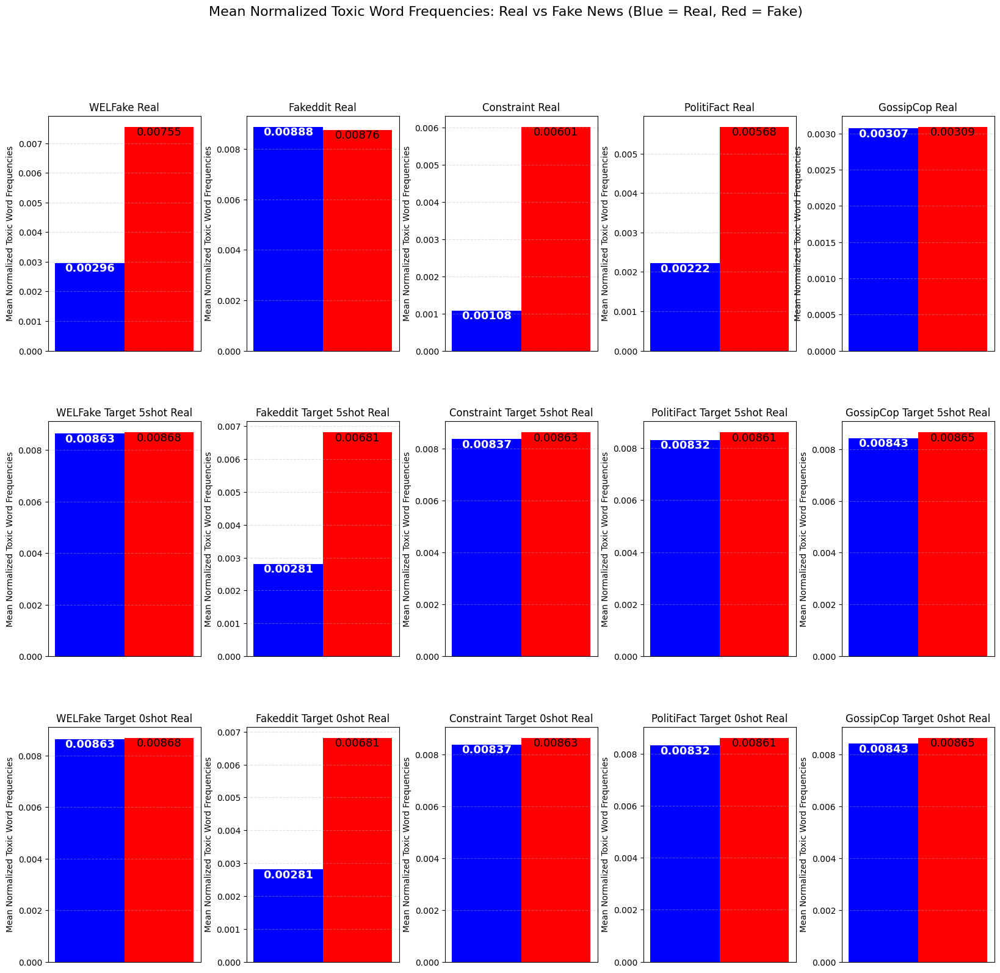

In [38]:
lang_quality_analyzer.plotQualityScoresRealVsFakeNewsSideBySide(
    mean_toxicity_scores_df,
    "mean_normalized_toxic_word_frequency",
    "Mean Normalized Toxic Word Frequencies"
)

- For three datasets (WELFake, Constraint, and PolitiFact), the average toxic-word score per text was higher for fake news than for real news.
- For GossipCop, the score was almost equal.
- For Fakeddit, the trend was reversed once more, with slightly higher score for real news than for fake news.
- Overall, for the combined datasets, the discrepancy in the Fakeddit dataset (the majority of samples coming from this dataset) meant that the score was only very slightly higher for fake news than for real news when this dataset was included, but **much** higher when it was the target (excluded) dataset.

### Analyzing Misspelled Word Scores For Real vs Fake News

In [39]:
# Calculate mean misspelled word scores for the five full-scale datasets

# WELFake
wf_real_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    wf_df_real,
    "WELFake_Real"
)
wf_fake_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    wf_df_fake,
    "WELFake_Fake"
)

# Fakeddit
fe_real_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    fe_df_real,
    "Fakeddit_Real"
)
fe_fake_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    fe_df_fake,
    "Fakeddit_Fake"
)

# Constraint
ct_real_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    ct_df_real,
    "Constraint_Real"
)
ct_fake_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    ct_df_fake,
    "Constraint_Fake"
)

# PolitiFact
pf_real_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    pf_df_real,
    "PolitiFact_Real"
)
pf_fake_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    pf_df_fake,
    "PolitiFact_Fake"
)

# GossipCop
gc_real_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    gc_df_real,
    "GossipCop_Real"
)
gc_fake_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    gc_df_fake,
    "GossipCop_Fake"
)











alculating misspelled word frequencies for GossipCop_Fake: 100%|█| 4020/4020 [00:07<00:00, 560.26it

In [40]:
# Calculating mean misspelled word scores for all five-shot datasets

# Target: WELFake
wf_real_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    wf_tgt_5shot_df_real,
    "WELFake_Target_5shot_Real"
)
wf_fake_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    wf_tgt_5shot_df_fake,
    "WELFake_Target_5shot_Fake"
)

# Target: Fakeddit
fe_real_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    fe_tgt_5shot_df_real,
    "Fakeddit_Target_5shot_Real"
)
fe_fake_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    fe_tgt_5shot_df_fake,
    "Fakeddit_Target_5shot_Fake"
)

# Target: Constraint
ct_real_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    ct_tgt_5shot_df_real,
    "Constraint_Target_5shot_Real"
)
ct_fake_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    ct_tgt_5shot_df_fake,
    "Constraint_Target_5shot_Fake"
)

# Target: PolitiFact
pf_real_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    pf_tgt_5shot_df_real,
    "PolitiFact_Target_5shot_Real"
)
pf_fake_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    pf_tgt_5shot_df_fake,
    "PolitiFact_Target_5shot_Fake"
)

# Target: GossipCop
gc_real_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    gc_tgt_5shot_df_real,
    "GossipCop_Target_5shot_Real"
)
gc_fake_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    gc_tgt_5shot_df_fake,
    "GossipCop_Target_5shot_Fake"
)











alculating misspelled word frequencies for GossipCop_Target_5shot_Fake: 100%|█| 309031/309031 [00:4

In [41]:
# Target: PolitiFact
pf_real_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    pf_tgt_5shot_df_real,
    "PolitiFact_Target_5shot_Real"
)
pf_fake_5shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    pf_tgt_5shot_df_fake,
    "PolitiFact_Target_5shot_Fake"
)



alculating misspelled word frequencies for PolitiFact_Target_5shot_Fake: 100%|█| 311382/311382 [00:

In [42]:
# Calculating mean misspelled word scores for all zero-shot datasets

# Target: WELFake
wf_real_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    wf_tgt_0shot_df_real,
    "WELFake_Target_0shot_Real"
)
wf_fake_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    wf_tgt_0shot_df_fake,
    "WELFake_Target_0shot_Fake"
)

# Target: Fakeddit
fe_real_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    fe_tgt_0shot_df_real,
    "Fakeddit_Target_0shot_Real"
)
fe_fake_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    fe_tgt_0shot_df_fake,
    "Fakeddit_Target_0shot_Fake"
)

# Target: Constraint
ct_real_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    ct_tgt_0shot_df_real,
    "Constraint_Target_0shot_Real"
)
ct_fake_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    ct_tgt_0shot_df_fake,
    "Constraint_Target_0shot_Fake"
)

# Target: PolitiFact
pf_real_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    pf_tgt_0shot_df_real,
    "PolitiFact_Target_0shot_Real"
)
pf_fake_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    pf_tgt_0shot_df_fake,
    "PolitiFact_Target_0shot_Fake"
)

# Target: GossipCop
gc_real_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    gc_tgt_0shot_df_real,
    "GossipCop_Target_0shot_Real"
)
gc_fake_0shot_misspelled_df = lang_quality_analyzer.calculateMeanScoresForMisspelledWordFrequencies(
    gc_tgt_0shot_df_fake,
    "GossipCop_Target_0shot_Fake"
)











alculating misspelled word frequencies for GossipCop_Target_0shot_Fake: 100%|█| 309031/309031 [00:4

In [43]:
# Concatenates the mean misspelled words scores into a single DF for plotting
mean_misspelled_words_scores_df = pd.concat([
    wf_real_misspelled_df, wf_fake_misspelled_df,
    fe_real_misspelled_df, fe_fake_misspelled_df,
    ct_real_misspelled_df, ct_fake_misspelled_df,
    pf_real_misspelled_df, pf_fake_misspelled_df,
    gc_real_misspelled_df, gc_fake_misspelled_df,
    wf_real_5shot_misspelled_df, wf_fake_5shot_misspelled_df,
    fe_real_5shot_misspelled_df, fe_fake_5shot_misspelled_df,
    ct_real_5shot_misspelled_df, ct_fake_5shot_misspelled_df,
    pf_real_5shot_misspelled_df, pf_fake_5shot_misspelled_df,
    gc_real_5shot_misspelled_df, gc_fake_5shot_misspelled_df,
    wf_real_0shot_misspelled_df, wf_fake_0shot_misspelled_df,
    fe_real_0shot_misspelled_df, fe_fake_0shot_misspelled_df,
    ct_real_0shot_misspelled_df, ct_fake_0shot_misspelled_df,
    pf_real_0shot_misspelled_df, pf_fake_0shot_misspelled_df,
    gc_real_0shot_misspelled_df, gc_fake_0shot_misspelled_df
])

mean_misspelled_words_scores_df.head(10)

,mean_normalized_misspelled_word_frequency
WELFake_Real,0.030566
WELFake_Fake,0.042653
Fakeddit_Real,0.092202
Fakeddit_Fake,0.086782
Constraint_Real,0.159576
Constraint_Fake,0.151114
PolitiFact_Real,0.032565
PolitiFact_Fake,0.043380
GossipCop_Real,0.049064
GossipCop_Fake,0.046583


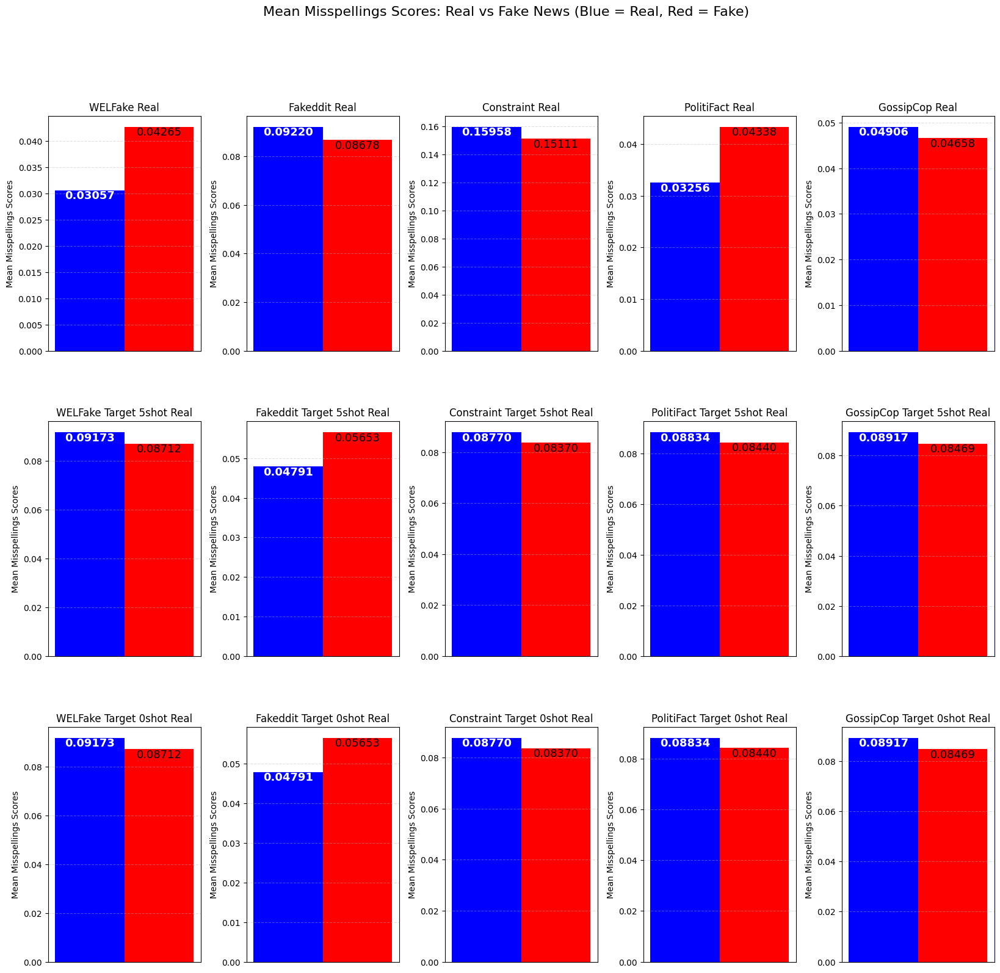

In [44]:
lang_quality_analyzer.plotQualityScoresRealVsFakeNewsSideBySide(
    mean_misspelled_words_scores_df,
    "mean_normalized_misspelled_word_frequency",
    "Mean Misspellings Scores"
)
    

Unfortunately, for misspelled words, tendencies vary substantially across the datasets. WELFake and PolitiFact (the political-news datasets) contain more misspelled words on average in fake than real news. However, for the other three datasets, the tendency is reversed, with real news containing more misspelled words, indicating a different strategy for producing disinformation articles, and highlighting the challenge of cross-domain generalization.

## 3. Analyzing Named Entity Distributions in Fake vs Real News

- Named entities are nouns which refer to specific kinds of objects inc. people, companies, or locations
- Analyzing them can help to detect key topics and styles which differentiate fake news from real news
- The named entity patterns that are strongest and most persistent across datasets can indicate which entities to extract for improving classifier performance
- Named entity word clouds can also help identify which entities have been the most frequent targets of disinformation campaigns based on the datasets

In [48]:
# First, get the list of the named entity types in the SpaCy library

# Loads in the large English spaCy model
nlp = spacy.load("en_core_web_lg")

# Extracts the Named Entity Recognizer (NER) labels using get_pipe: extracts a pipeline component for a given component name (here: "ner")
ner_labels = nlp.get_pipe("ner").labels # Get the labels out of the NER object

# Prints the named entity types and explanations of what they are using spacy.explain
print(f"There are {len(ner_labels)} types of named entity types in the SpaCy library.\n")
for label in ner_labels:
    print(f"{label} - {spacy.explain(label)}")

There are 18 types of named entity types in the SpaCy library.

CARDINAL - Numerals that do not fall under another type
DATE - Absolute or relative dates or periods
EVENT - Named hurricanes, battles, wars, sports events, etc.
FAC - Buildings, airports, highways, bridges, etc.
GPE - Countries, cities, states
LANGUAGE - Any named language
LAW - Named documents made into laws.
LOC - Non-GPE locations, mountain ranges, bodies of water
MONEY - Monetary values, including unit
NORP - Nationalities or religious or political groups
ORDINAL - "first", "second", etc.
ORG - Companies, agencies, institutions, etc.
PERCENT - Percentage, including "%"
PERSON - People, including fictional
PRODUCT - Objects, vehicles, foods, etc. (not services)
QUANTITY - Measurements, as of weight or distance
TIME - Times smaller than a day
WORK_OF_ART - Titles of books, songs, etc.


Patterns in frequencies of these 16 (out of 18) named entities might be specifically relevant to distinguishing between real news and disinformation:

- **PERSON**: disinformation campaigns frequently try to attack the reputations of famous people like politicians
- **ORG**: organizations, such as businesses, might also be targeted to cause loss in their share prices and financial damage
- **EVENT**: events e.g. elections, sports competitions, are often the topic of propaganda and disinformation campaigns
- **LAW**: the same as above applies to various governmental laws or bills being passed, they can also be subject to political attacks
- **GPE** (countries, cities, states): political misinformation often focuses on geopolitical crises. This in contrast to the "LOC" named entity, which focuses more on geographical features of countries such as rivers or mountain ranges, which are less likely to be the target of a political disinformation campaign.
- **NORP**: nationalities and religious groups are often frequently targeted with stereotypes or inciting violence against these groups
- **LANGUAGE**: might also be relevant to fake news where specific nationalities and countries are the object of fake news attacks
- **MONEY**: fake news about expenses scandals, or corruption might also include a greater frequency count of money-related references
- **Quantitative Named Entities** = **CARDINAL**, **ORDINAL**, **PERCENT**, **QUANTITY**, **DATE**, **TIME**: fake news articles about politics, technology, or health might involve more markers of fact-based and quantitative language to try to convince readers of their objectivity
- **PRODUCT**: disinformation campaigns might involve targeting the credibility of a company's products to try to cause them damage
- **WORK_OF_ART**: books, songs, and movies might be particularly relevant to disinformation applying to entertainment news (GossipCop)

In [ ]:
class NamedEntityAnalyzer:

    """
     A class for calculating Named Entity frequency counts for comparing real vs fake news patterns across datasets.
    """
    
    def __init__(self):
        # Creates a list of the 16 (out of 18) most-relevant named entities to focus on for the analysis
        # Excludes the LOC and FAC named entities as they might be less informative for the fake news detection objective, to save time
        self.named_entities = [
            "CARDINAL", "DATE",
            "EVENT", "GPE", "LANGUAGE",
            "LAW", "MONEY", "NORP", "ORG",
            "ORDINAL", "PERCENT", "PERSON",
            "PRODUCT", "QUANTITY",
            "TIME", "WORK_OF_ART"
        ]

        # Loads in the large English SpaCy model for named entity extraction
        self.nlp = spacy.load("en_core_web_lg")  
        print("Loaded the SpaCy large English model")

    def calculateNamedEntityFrequencies(self, df, dataset_name, save_path="../FPData/NamedEntityFreqs"):
        """
        Calculates normalized (by num of word tokens in each text) frequencies of named entities
        in news texts for a specific DataFrame using the SpaCy library, and then returns the updated DataFrame
        with a column for each named entity from a pre-set list, as well as dictionary and DataFrame storing
        the mean named entity frequencies for each type of the 16 named entities for this dataset.
        Also saves the results to .csv file and stores it on local disk in case of errors.
        
        Input Parameters:
        df (pd.DataFrame): The pandas DataFrame containing the texts for the named entity extraction task.
        dataset_name (str): The name of the dataset for the Index of the new average frequencies dict.
        
        Returns:
        pd.DataFrame: The original news DataFrame with added named entity frequency columns.
        dict: A dictionary with the mean named entity frequencies for the entire DataFrame.
        pd.DataFrame: A pandas DataFrame with the mean named entity frequencies for the entire DataFrame
        """
        
        # Creates a copy of the DataFrame 
        ner_df = df.copy()

        # Creates a new column in the entity DataFrame for each targeted type of SpaCy named entity, initialize value to 0.0
        for entity in self.named_entities:
            ner_df[entity] = 0.0 

        # Sets up the tqdm progress bar as before based on total row count
        total_rows = len(ner_df)
        with tqdm(total=total_rows, desc=f"Calculating normalized named entity frequencies for {dataset_name}", 
                  position=0, leave=True, ncols=100) as progress_bar:
            # Loops through each row to extract the row index and the news text content
            for idx, row in ner_df.iterrows():

                # Extracts the individual text field's value from the row
                text = row["text"]
                
                # Converts the news text into an NLP document object for extracting the named entities
                doc = self.nlp(text)
                
                # Calculates the total number of word tokens in the text (excluding non-all-alphabetic words such as numbers and punctuation)
                num_tokens = len([token for token in doc if token.is_alpha])
                
                # Loops through all the named entities found in the text using a dict comprehension
                entity_counts = {entity: 0 for entity in self.named_entities}  # Init each freq to 0 to start

                # Iterates over the entities in the doc/text
                for ent in doc.ents:
                    
                    # Checks that the extracted label is one of the selected named entities in this class
                    if ent.label_ in self.named_entities:
                        entity_counts[ent.label_] += 1  # Increment the count for this entity

                # Normalizes by the number of word tokens in the text
                for entity in self.named_entities:
                    if num_tokens > 0:  # Prevents the case of potential division by zero for empty string texts
                        ner_df.at[idx, entity] = entity_counts[entity] / num_tokens  # Update the freq for this row, access the column
                    else:
                        ner_df.at[idx, entity] = 0.0 # Sets it to 0.0 if no tokens in the text

                # Updates the progress bar after processing each row
                progress_bar.update(1)

        # Calculates the mean normalized frequencies for each entity across all texts
        mean_entity_frequencies_dict = ner_df[self.named_entities].mean().to_dict()  # Convert the Series to a dict

        # Converts the dict to a pandas DataFrame for the mean frequencies -> use the dataset name as the index for the single-row DataFrame
        mean_entity_df = pd.DataFrame([mean_entity_frequencies_dict], index=[dataset_name])

        # Saves the DF to disk
        mean_entity_df.to_csv(os.path.join(save_path, f"{dataset_name}_normalized_mean_named_entity_frequencies.csv"), index=True)

        return ner_df, mean_entity_frequencies_dict, mean_entity_df


    def getFreqDistOfNamedEntitiesForDataFrame(self, df, dataset_name):
        """
            Calculates a frequency distribution (dict) of all the selected named entities in a DataFrame.
            Returns a dictionary with entity texts as keys and their counts as values.
            
            Input Parameters:
            df (pd.DataFrame): The DataFrame containing the texts for named entity extraction.
            
            Returns:
            dict: A dictionary with named entities (text) as keys and their counts as values.
        """
        # Defines an empty dict for storing named entity frequencies for the dataset
        named_entity_freq_distribution = {}

        # Processes each row in the DataFrame and add tqdm to monitor progress
        total_rows = len(df)
        with tqdm(total=total_rows, desc=f"Calculating Named Entity Distribution for {dataset_name}...", 
                  position=0, leave=True, ncols=100) as p_bar:
            
            # Iterates over rows in the dataset
            for idx, row in df.iterrows():
                
                # Gets the text out
                text = row["text"]
                # Converts to SpaCy NLP doc
                doc = self.nlp(text)
                
                # Gets the named entitites out
                for entity in doc.ents:
                    
                    # Increments the count for each named entity in the general named_entity_freq_distribution dict
                    named_entity_freq_distribution[entity.text] = named_entity_freq_distribution.get(entity.text, 0) + 1
                    
                # Updates the progress bar
                p_bar.update(1)

        # Converts the frequency distribution dictionary into a single-row DataFrame for later concatenation and plotting
        # with the other datasets (real vs fake news); the column is for the dicts storing the frequency distributions
        named_entity_df = pd.DataFrame({
            "named_entity_freq_dict": [named_entity_freq_distribution]
        })

        # Sets the dataset name as the index
        named_entity_df.index = [dataset_name]

        return named_entity_df

    def plotMeanNamedEntityFrequenciesRealVsFakeNewsSideBySide(self, df):
        """
        Creates a 15x1 grid of bar charts showing mean named entity frequencies for real vs fake news
        for 16 named entities across the 15 news datasets.
        
        Input Parameters:
        df (pd.DataFrame): a pandas DataFrame containing the normalized mean frequency counts for real and fake news 
                           for the 16 seleted SpaCy named entities across 15 datasets.
        """

        # Defines the number of rows and columns for the grid
        num_datasets = len(df.index) // 2  # Each dataset is split into real and fake rows, so // by 2

        # Gets the number of named entities based on the number of columns in the inputted mean NE frequency DataFrame
        num_entities = len(df.columns)  # Number of named entities (16)

         # Creates the plot: 15 (num_datasets) rows, 1 column
        fig, axes = plt.subplots(num_datasets, 1, figsize=(12, 4 * num_datasets))

         # Sets the bar width for real vs fake news bars
        bar_width = 0.4
    
        # Extracts the named entity labels
        entity_labels = df.columns
    
        # Extracts the dataset names from the mean freq df index object
        dataset_names = df.index

        # Iterates over the datasets (15 rows)
        for i in range(num_datasets):
            
            # Gets the indices for the real and fake dataset rows
            real_idx = i * 2
            fake_idx = real_idx + 1

            # Gets the dataset name from the index
            real_dataset_name = dataset_names[real_idx]
            fake_dataset_name = dataset_names[fake_idx]

            # Gets the named entity frequency scores by using the dataset names to index into the mean freqs DF
            real_scores = df.iloc[real_idx]
            fake_scores = df.iloc[fake_idx]
    
            # Calculates the x-positions for 16 named entity side-by-side bars (real vs fake news) using numpy arange func
            x_positions = np.arange(num_entities)

             # Plots by accessing the correct axes obj with the 'i' index from the loop
            ax = axes[i]

             # Uses the x_positions for the 16 named entities to plot the side-by-side bars, 0.4 bar width
            ax.bar(x_positions - bar_width / 2, real_scores, width=bar_width, color="blue", label="Real")
            ax.bar(x_positions + bar_width / 2, fake_scores, width=bar_width, color="red", label="Fake")
    
            # Sets the titles and labels
            dataset_title = ' '.join(real_dataset_name.split('_')) # Remove underscores from dataset name
            # Removes the "Real" from the dataset_title extracted from the real news dataset name
            dataset_title = dataset_title.replace("Real", "")
            ax.set_title(dataset_title, fontsize=14)

            # Sets the x-tick labels to the 16 SpaCy entity names
            ax.set_xticks(x_positions)
            ax.set_xticklabels(entity_labels, rotation=45) # Rotate entity labels to prevent overlapping

            # Sets the y-labels
            ax.set_ylabel("Mean Frequency")
    
            # Adds value labels on real vs fake side-by-side bars, center the labels horizontally, get scores to 3 decimal points
            for j, (real_score, fake_score) in enumerate(zip(real_scores, fake_scores)):
                ax.text(j - bar_width / 2 - 0.1, real_score, f"{real_score:.3f}", ha="center", va="bottom", fontsize=6)
                ax.text(j + bar_width / 2 + 0.1, fake_score, f"{fake_score:.3f}", ha="center", va="bottom", fontsize=6)
    
            # Adds gridlines to the background for better readability
            ax.grid(axis="y", linestyle="--", alpha=0.7)
            
        # Adds the main title
        fig.suptitle(
            f"Mean Named Entity Frequencies for Real vs Fake News Across {num_datasets} Datasets",
            fontsize=16,
            y=0.99 # Adjust the pos to ensure title is not cut off
        )
    
        # Adjusts the top margin to create space for the main title
        plt.subplots_adjust(top=0.97, hspace=0.4)
    
        # Shows the grid
        plt.show()

    def plotNamedEntityWordCloudsForRealVsFake(self, df):
        """
        Plots a 15-row x 2-column grid comparing word clouds for real vs fake news using dicts containing
        named entity frequencies for each (real and fake) dataset section. Each row represents a dataset,
        and each column represents whether the news is real or fake.
    
        Input Parameters:
        df (pd.DataFrame): A pandas DataFrame with 30 rows, containing:
                           - Index: Dataset names, containing the evaluation scenario, such as full-scale 
                               or zero-shot, whether the data is real or fake news, and name of either
                               the source (full-scale) or target (five-shot and zero-shot scenarios) dataset.
                           - A column called "named_entity_freq_dict": String representation of a dictionary
                               with named entity frequency counts for each dataset section (real or fake).
        """
        # Converts the string representations of dicts to actual dicts only if they are strings
        df["named_entity_freq_dict"] = df["named_entity_freq_dict"].apply(
            lambda x: eval(x) if isinstance(x, str) else x
        )
    
        # Creates the 15x2 grid
        fig, axes = plt.subplots(15, 2, figsize=(20, 7 * (len(df) // 2)))  # Adjust size based on datasets
        plt.subplots_adjust(hspace=0.4, wspace=0.2)  # Adjust spacing between plots to prevent overlap
    
        # Iterates in steps of 2 to get real-fake news pairs for each dataset in the DataFrame
        for i in range(0, len(df), 2):
            # Extracts the dataset names for real vs fake news and clean them by removing the _
            real_news_dataset_name = ' '.join(df.index[i].split('_'))
            fake_news_dataset_name = ' '.join(df.index[i + 1].split('_'))
    
            # Extracts the real-news and fake-news dictionaries
            real_news_dict = df.iloc[i]["named_entity_freq_dict"]
            fake_news_dict = df.iloc[i + 1]["named_entity_freq_dict"]
    
            # Real news word cloud
            real_wc = WordCloud(
                background_color="white",
                colormap="viridis",
                width=800,
                height=400
            ).generate_from_frequencies(real_news_dict)
    
            # Fake news word cloud
            fake_wc = WordCloud(
                background_color="black",
                colormap="inferno",
                width=800,
                height=400
            ).generate_from_frequencies(fake_news_dict)
    
            # Determines the row index for the subplot
            row = i // 2
    
            # Plots the real news word cloud
            axes[row, 0].imshow(real_wc, interpolation="bilinear")
            axes[row, 0].axis("off")
            axes[row, 0].set_title(f"{real_news_dataset_name}", fontsize=16)
    
            # Plots the fake news word cloud
            axes[row, 1].imshow(fake_wc, interpolation="bilinear")
            axes[row, 1].axis("off")
            axes[row, 1].set_title(f"{fake_news_dataset_name}", fontsize=16)
    
        plt.show()


    def plotNamedEntityWordCloudsForRealVsFakeSetDifference(self, df):
        """
        Plots a 15-row x 2-column grid comparing word clouds for real vs fake news using dicts containing
        named entity frequencies for each (real and fake) dataset section. Each row represents a dataset,
        and each column represents whether the news is real or fake. These word clouds show words that are 
        EXCLUSIVE (XOR) to EITHER real news or fake news, but which do NOT appear in both real news and 
        fake news, to make it easier to spot the differences in entity distributions between the two
        news categories.
    
        Input Parameters:
        df (pd.DataFrame): A pandas DataFrame with 30 rows, containing:
                           - Index: Dataset names, containing the evaluation scenario, such as full-scale 
                               or zero-shot, whether the data is real or fake news, and name of either
                               the source (full-scale) or target (five-shot and zero-shot scenarios) dataset.
                           - A column called "named_entity_freq_dict": String representation of a dictionary
                               with named entity frequency counts for each dataset section (real or fake).
        """
        # Converts the string representations of dicts to actual dicts only if they are strings
        df["named_entity_freq_dict"] = df["named_entity_freq_dict"].apply(
            lambda x: eval(x) if isinstance(x, str) else x
        )
    
        # Creates the 15x2 grid
        fig, axes = plt.subplots(15, 2, figsize=(20, 7 * (len(df) // 2)))  # Adjust size based on datasets
        plt.subplots_adjust(hspace=0.4, wspace=0.2)  # Adjust spacing between plots to prevent overlap
    
        # Iterates in steps of 2 to get real-fake news pairs for each dataset in the DataFrame
        for i in range(0, len(df), 2):
            # Extracts the dataset names for real vs fake news and clean them by removing the _
            real_news_dataset_name = ' '.join(df.index[i].split('_')).replace("Real", "Exclusive to Real News")
            fake_news_dataset_name = ' '.join(df.index[i + 1].split('_')).replace("Fake", "Exclusive to Fake News")
    
            # Extracts the real-news and fake-news dictionaries
            real_news_dict = df.iloc[i]["named_entity_freq_dict"]
            fake_news_dict = df.iloc[i + 1]["named_entity_freq_dict"]
    
            # Calculates the set difference for the real and fake news dictionaries for this particular dataset
            real_exclusive_keys = set(real_news_dict.keys()) - set(fake_news_dict.keys())
            fake_exclusive_keys = set(fake_news_dict.keys()) - set(real_news_dict.keys())
    
            # Creates new dictionaries containing unique words for real and fake news categories
            # Cleans the keys by removing newlines and special characters, otherwise we get a lot of ValueErrors
            # indicating invalid dict keys
            real_exclusive_dict = {
                str(key).strip().replace('\n', ' '): real_news_dict[key] # WordCloud cannot handle newlines in dict keys, so replace
                for key in real_exclusive_keys 
                if key and str(key).strip() # Check if key is valid (i.e. not False, so not empty string or other empty data structure)
            }
            fake_exclusive_dict = {
                str(key).strip().replace('\n', ' '): fake_news_dict[key] 
                for key in fake_exclusive_keys 
                if key and str(key).strip()
            }
    
            # Handles empty dictionaries to prevent WordCloud errors, by setting a key called NO_UNIQUE_ENTITIES
            if not real_exclusive_dict:
                real_exclusive_dict = {"NO_UNIQUE_ENTITIES": 1}
            if not fake_exclusive_dict:
                fake_exclusive_dict = {"NO_UNIQUE_ENTITIES": 1}
    
            # Real news set difference word cloud
            real_wc = WordCloud(
                background_color="white",
                colormap="viridis",
                width=800,
                height=400,
                prefer_horizontal=0.7
            ).generate_from_frequencies(real_exclusive_dict)
    
            # Fake news set difference word cloud
            fake_wc = WordCloud(
                background_color="black",
                colormap="inferno",
                width=800,
                height=400,
                prefer_horizontal=0.7
            ).generate_from_frequencies(fake_exclusive_dict)
    
            # Determines the row index for the subplot
            row = i // 2
    
            # Plots the real news set difference word cloud
            axes[row, 0].imshow(real_wc, interpolation="bilinear")
            axes[row, 0].axis("off")
            axes[row, 0].set_title(f"{real_news_dataset_name}", fontsize=16)
    
            # Plots the fake news set difference word cloud
            axes[row, 1].imshow(fake_wc, interpolation="bilinear")
            axes[row, 1].axis("off")
            axes[row, 1].set_title(f"{fake_news_dataset_name}", fontsize=16)
            
        plt.show()

In [50]:
ne_analyzer = NamedEntityAnalyzer()

Loaded the SpaCy large English model


### Extracting Mean (Normalized by Text Length in Word Tokens) Frequency Counts for 16 SpaCy Named Entities for Fake vs Real News for all Datasets

In [ ]:
wf_real_entities_df, wf_real_mean_entities_dict, wf_real_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    wf_df_real,
    "WELFake_Real"
)
wf_fake_entities_df, wf_fake_mean_entities_dict, wf_fake_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    wf_df_fake,
    "WELFake_Fake"
)

In [ ]:
# Calculates the mean named entity frequencies for all the full-scale datasets

# Fakeddit
fe_real_entities_df, fe_real_mean_entities_dict, fe_real_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    fe_df_real,
    "Fakeddit_Real"
)
fe_fake_entities_df, fe_fake_mean_entities_dict, fe_fake_mean_entities_df  = ne_analyzer.calculateNamedEntityFrequencies(
    fe_df_fake,
    "Fakeddit_Fake"
)

# Constraint
ct_real_entities_df, ct_real_mean_entities_dict, ct_real_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    ct_df_real,
    "Constraint_Real"
)
ct_fake_entities_df, ct_fake_mean_entities_dict, ct_fake_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    ct_df_fake,
    "Constraint_Fake"
)


# PolitiFact
pf_real_entities_df, pf_real_mean_entities_dict, pf_real_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    pf_df_real,
    "PolitiFact_Real"
)
pf_fake_entities_df, pf_fake_mean_entities_dict, pf_fake_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    pf_df_fake,
    "PolitiFact_Fake"
)

# GossipCop
gc_real_entities_df, gc_real_mean_entities_dict, gc_real_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    gc_df_real,
    "GossipCop_Real"
)
gc_fake_entities_df, gc_fake_mean_entities_dict, gc_fake_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    gc_df_fake,
    "GossipCop_Fake"
)

In [ ]:
# Calculates the mean named entity frequencies for all the five_shot datasets

# Target: WELFake
wf_real_5shot_entities_df, wf_real_5shot_mean_entities_dict, wf_real_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    wf_tgt_5shot_df_real,
    "WELFake_Target_5shot_Real"
)
wf_fake_5shot_entities_df, wf_fake_5shot_mean_entities_dict, wf_fake_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    wf_tgt_5shot_df_fake,
    "WELFake_Target_5shot_Fake"
)

# Target: Fakeddit
fe_real_5shot_entities_df, fe_real_5shot_mean_entities_dict, fe_real_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    fe_tgt_5shot_df_real,
    "Fakeddit_Target_5shot_Real"
)
fe_fake_5shot_entities_df, fe_fake_5shot_mean_entities_dict, fe_fake_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    fe_tgt_5shot_df_fake,
    "Fakeddit_Target_5shot_Fake"
)

# Target: Constraint
ct_real_5shot_entities_df, ct_real_5shot_mean_entities_dict, ct_real_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    ct_tgt_5shot_df_real,
    "Constraint_Target_5shot_Real"
)
ct_fake_5shot_entities_df, ct_fake_5shot_mean_entities_dict, ct_fake_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    ct_tgt_5shot_df_fake,
    "Constraint_Target_5shot_Fake"
)

# Target: PolitiFact
pf_real_5shot_entities_df, pf_real_5shot_mean_entities_dict, pf_real_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    pf_tgt_5shot_df_real,
    "PolitiFact_Target_5shot_Real"
)
pf_fake_5shot_entities_df, pf_fake_5shot_mean_entities_dict, pf_fake_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    pf_tgt_5shot_df_fake,
    "PolitiFact_Target_5shot_Fake"
)

# Target: GossipCop
gc_real_5shot_entities_df, gc_real_5shot_mean_entities_dict, gc_real_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    gc_tgt_5shot_df_real,
    "GossipCop_Target_5shot_Real"
)
gc_fake_5shot_entities_df, gc_fake_5shot_mean_entities_dict, gc_fake_5shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    gc_tgt_5shot_df_fake,
    "GossipCop_Target_5shot_Fake"
)

In [ ]:
# Calculates the mean named entity frequencies for all the zero_shot datasets

# Target: WELFake
wf_real_0shot_entities_df, wf_real_0shot_mean_entities_dict, wf_real_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    wf_tgt_0shot_df_real,
    "WELFake_Target_0shot_Real"
)
wf_fake_0shot_entities_df, wf_fake_0shot_mean_entities_dict, wf_fake_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    wf_tgt_0shot_df_fake,
    "WELFake_Target_0shot_Fake"
)

# Target: Fakeddit
fe_real_0shot_entities_df, fe_real_0shot_mean_entities_dict, fe_real_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    fe_tgt_0shot_df_real,
    "Fakeddit_Target_0shot_Real"
)
fe_fake_0shot_entities_df, fe_fake_0shot_mean_entities_dict, fe_fake_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    fe_tgt_0shot_df_fake,
    "Fakeddit_Target_0shot_Fake"
)

# Target: Constraint
ct_real_0shot_entities_df, ct_real_0shot_mean_entities_dict, ct_real_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    ct_tgt_0shot_df_real,
    "Constraint_Target_0shot_Real"
)
ct_fake_0shot_entities_df, ct_fake_0shot_mean_entities_dict, ct_fake_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    ct_tgt_0shot_df_fake,
    "Constraint_Target_0shot_Fake"
)

# Target: PolitiFact
pf_real_0shot_entities_df, pf_real_0shot_mean_entities_dict, pf_real_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    pf_tgt_0shot_df_real,
    "PolitiFact_Target_0shot_Real"
)
pf_fake_0shot_entities_df, pf_fake_0shot_mean_entities_dict, pf_fake_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    pf_tgt_0shot_df_fake,
    "PolitiFact_Target_0shot_Fake"
)

# Target: GossipCop
gc_real_0shot_entities_df, gc_real_0shot_mean_entities_dict, gc_real_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    gc_tgt_0shot_df_real,
    "GossipCop_Target_0shot_Real"
)
gc_fake_0shot_entities_df, gc_fake_0shot_mean_entities_dict, gc_fake_0shot_mean_entities_df = ne_analyzer.calculateNamedEntityFrequencies(
    gc_tgt_0shot_df_fake,
    "GossipCop_Target_0shot_Fake"
)

In [51]:
# Loads in the saved named entity freq DFs
load_path = "../FPData/NamedEntityFreqs"

wf_real_mean_entities_df = pd.read_csv(os.path.join(load_path, "WELFake_Real_normalized_mean_named_entity_frequencies.csv"), index_col=0)
wf_fake_mean_entities_df = pd.read_csv(os.path.join(load_path, "WELFake_Fake_normalized_mean_named_entity_frequencies.csv"), index_col=0)

fe_real_mean_entities_df = pd.read_csv(os.path.join(load_path, "Fakeddit_Real_normalized_mean_named_entity_frequencies.csv"), index_col=0)
fe_fake_mean_entities_df = pd.read_csv(os.path.join(load_path, "Fakeddit_Fake_normalized_mean_named_entity_frequencies.csv"), index_col=0)

ct_real_mean_entities_df = pd.read_csv(os.path.join(load_path, "Constraint_Real_normalized_mean_named_entity_frequencies.csv"), index_col=0)
ct_fake_mean_entities_df = pd.read_csv(os.path.join(load_path, "Constraint_Fake_normalized_mean_named_entity_frequencies.csv"), index_col=0)

pf_real_mean_entities_df = pd.read_csv(os.path.join(load_path, "PolitiFact_Real_normalized_mean_named_entity_frequencies.csv"), index_col=0)
pf_fake_mean_entities_df = pd.read_csv(os.path.join(load_path, "PolitiFact_Fake_normalized_mean_named_entity_frequencies.csv"), index_col=0)

gc_real_mean_entities_df = pd.read_csv(os.path.join(load_path, "GossipCop_Real_normalized_mean_named_entity_frequencies.csv"), index_col=0)
gc_fake_mean_entities_df = pd.read_csv(os.path.join(load_path, "GossipCop_Fake_normalized_mean_named_entity_frequencies.csv"), index_col=0)

wf_real_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "WELFake_Target_5shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
wf_fake_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "WELFake_Target_5shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
fe_real_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "Fakeddit_Target_5shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
fe_fake_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "Fakeddit_Target_5shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
ct_real_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "Constraint_Target_5shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
ct_fake_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "Constraint_Target_5shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
pf_real_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "PolitiFact_Target_5shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
pf_fake_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "PolitiFact_Target_5shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
gc_real_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "GossipCop_Target_5shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
gc_fake_5shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "GossipCop_Target_5shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )

wf_real_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "WELFake_Target_0shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
wf_fake_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "WELFake_Target_0shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )

fe_real_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "Fakeddit_Target_0shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
fe_fake_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "Fakeddit_Target_0shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )

ct_real_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "Constraint_Target_0shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
ct_fake_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "Constraint_Target_0shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )

pf_real_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "PolitiFact_Target_0shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
pf_fake_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "PolitiFact_Target_0shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )

gc_real_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "GossipCop_Target_0shot_Real_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )
gc_fake_0shot_mean_entities_df = pd.read_csv(os.path.join(
                                                        load_path, "GossipCop_Target_0shot_Fake_normalized_mean_named_entity_frequencies.csv"),
                                                         index_col=0
                                            )

In [52]:
# Concatenates the mean normalized named entity frequency DFs

mean_entity_freq_concat_df = pd.concat(
    [
        wf_real_mean_entities_df, wf_fake_mean_entities_df,
        fe_real_mean_entities_df, fe_fake_mean_entities_df,
        ct_real_mean_entities_df, ct_fake_mean_entities_df,
        pf_real_mean_entities_df, pf_fake_mean_entities_df,
        gc_real_mean_entities_df, gc_fake_mean_entities_df,
        wf_real_5shot_mean_entities_df, wf_fake_5shot_mean_entities_df,
        fe_real_5shot_mean_entities_df, fe_fake_5shot_mean_entities_df,
        ct_real_5shot_mean_entities_df, ct_fake_5shot_mean_entities_df,
        pf_real_5shot_mean_entities_df, pf_fake_5shot_mean_entities_df,
        gc_real_5shot_mean_entities_df, gc_fake_5shot_mean_entities_df,
        wf_real_0shot_mean_entities_df, wf_fake_0shot_mean_entities_df,
        fe_real_0shot_mean_entities_df, fe_fake_0shot_mean_entities_df,
        ct_real_0shot_mean_entities_df, ct_fake_0shot_mean_entities_df,
        pf_real_0shot_mean_entities_df, pf_fake_0shot_mean_entities_df,
        gc_real_0shot_mean_entities_df, gc_fake_0shot_mean_entities_df,
    ]
)

In [53]:
# Displays the results for extracting mean named-entity frequency scores
mean_entity_freq_concat_df.head()

,CARDINAL,DATE,EVENT,GPE,LANGUAGE,LAW,MONEY,NORP,ORG,ORDINAL,PERCENT,PERSON,PRODUCT,QUANTITY,TIME,WORK_OF_ART
WELFake_Real,0.007778,0.018526,0.000388,0.026011,0.000081,0.000338,0.001355,0.011883,0.029045,0.001545,0.001092,0.026182,0.000373,0.000417,0.001208,0.000961
WELFake_Fake,0.007029,0.012263,0.000423,0.012102,0.000076,0.000446,0.001292,0.008021,0.023836,0.001408,0.000841,0.028243,0.000558,0.000276,0.001509,0.001211
Fakeddit_Real,0.008935,0.008055,0.000835,0.021694,0.000158,0.000148,0.002182,0.027510,0.022665,0.001400,0.000344,0.022738,0.001710,0.000783,0.001073,0.002219
Fakeddit_Fake,0.008199,0.024823,0.001981,0.013280,0.000190,0.000271,0.000524,0.008676,0.025276,0.002790,0.000200,0.031858,0.001913,0.000242,0.001299,0.003564
Constraint_Real,0.050309,0.026352,0.000381,0.020042,0.000050,0.000347,0.007394,0.002334,0.025252,0.001829,0.006630,0.010162,0.002213,0.000983,0.003865,0.000391


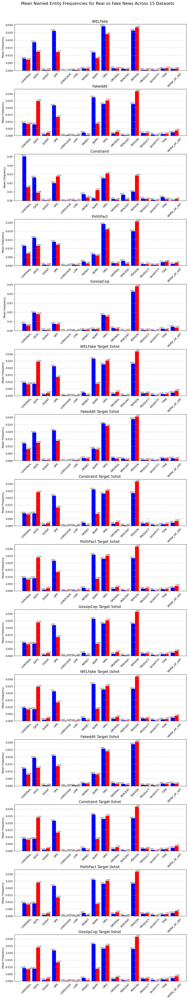

In [54]:
ne_analyzer.plotMeanNamedEntityFrequenciesRealVsFakeNewsSideBySide(mean_entity_freq_concat_df)

- All the datasets contain more CARDINAL (general numerals that don't fall into any other category) numbers in real news than in fake news, indicating that real news contains may contain quantitative facts and statistics than fake news. This also highlights the previous mistake made by removing numbers during text pre-processing; as this data analysis has shown, characters including numbers and punctuation could potentially improve classifier generalizability.
- The PERSON entity occurs more frequently in fake news than real news for all datasets, thus affirming the hypothesis that disinformation campaigns are often based upon targeting and damaging the reputation of specific individuals. However, for the ORG entity ("Companies, agencies, institutions, etc."), there was no generalizable pattern across the datasets.
- For all datasets except for the Fakeddit dataset, a greater frequency of DATE named entities is associated more with real than fake news, but for Fakeddit this tendency is strongly reversed, with fake news containing over 100% more DATE-entities than real news, thus underscoring the challenge of creating a more universal fake news detection system that generalizes to this particular dataset, due to its distinctive structure and format.
- For the other named entity types, the frequencies for real and fake news differed widely across the datasets, signalling a challenge for generalizability. NORP ("Nationalities or religious or political groups") frequencies were higher for real news than for fake news in the WELFake, Fakeddit and PolitiFact datasets, but much lower for real news in the Constraint dataset.

### Extracting the Frequency Distribution of Specific Instances of Named Entities for Real vs Fake News Across the Datasets (for plotting WordClouds)

I will now apply a function that outputs a DataFrame containing a dictionary with the frequency distribution of the specific named entities mentioned for real and fake news sections of each dataset, to allow users to visualize which entities have most frequently been the target of disinformation campaigns; a requirement which was met with great interest during the user interviews. This technique can also expose cultural bias of the datasets (if the data contains more references to specific cultures, events and countries, e.g. the U.S. 2016 presidential election, than to others).

In [55]:
wf_real_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(wf_df_real, "WELFake_Real")


alculating Named Entity Distribution for WELFake_Real...: 100%|█| 34617/34617 [21:06<00:00, 27.33it

In [56]:
# Full-scale datasets: extracting freq-dist of key named entities for real vs fake news

# WELFake Fake news dataset
wf_fake_specific_entity_df = ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(wf_df_fake, "WELFake_Fake")

# Fakeddit
fe_real_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(fe_df_real, "Fakeddit_Real")
fe_fake_specific_entity_df = ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(fe_df_fake, "Fakeddit_Fake")

# Constraint
ct_real_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(ct_df_real, "Constraint_Real")
ct_fake_specific_entity_df = ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(ct_df_fake, "Constraint_Fake")

# PolitiFact
pf_real_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(pf_df_real, "PolitiFact_Real")
pf_fake_specific_entity_df = ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(pf_df_fake, "PolitiFact_Fake")

# GossipCop
gc_real_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(gc_df_real, "GossipCop_Real")
gc_fake_specific_entity_df = ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(gc_df_fake, "GossipCop_Fake")










alculating Named Entity Distribution for GossipCop_Fake...: 100%|█| 4020/4020 [02:35<00:00, 25.92it

In [57]:
# Five-shot datasets: extracting freq-dist of key named entities for real vs fake news

# Target: WELFake
wf_real_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    wf_tgt_5shot_df_real,
    "WELFake_Target_5shot_Real"
)
wf_fake_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    wf_tgt_5shot_df_fake,
    "WELFake_Target_5shot_Fake"
)

# Target: Fakeddit
fe_real_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    fe_tgt_5shot_df_real,
    "Fakeddit_Target_5shot_Real"
)
fe_fake_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    fe_tgt_5shot_df_fake,
    "Fakeddit_Target_5shot_Fake"
)

# Target: Constraint
ct_real_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    ct_tgt_5shot_df_real,
    "Constraint_Target_5shot_Real"
)
ct_fake_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    ct_tgt_5shot_df_fake,
    "Constraint_Target_5shot_Fake"
)

# Target: PolitiFact
pf_real_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    pf_tgt_5shot_df_real,
    "PolitiFact_Target_5shot_Real"
)
pf_fake_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    pf_tgt_5shot_df_fake,
    "PolitiFact_Target_5shot_Fake"
)

# Target: GossipCop
gc_real_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    gc_tgt_5shot_df_real,
    "GossipCop_Target_5shot_Real"
)
gc_fake_5shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    gc_tgt_5shot_df_fake,
    "GossipCop_Target_5shot_Fake"
)











alculating Named Entity Distribution for GossipCop_Target_5shot_Fake...: 100%|█| 309031/309031 [18:

In [58]:
# Zero-shot datasets: extracting freq-dist of key named entities for real vs fake news

# Target: WELFake
wf_real_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    wf_tgt_0shot_df_real,
    "WELFake_Target_0shot_Real"
)
wf_fake_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    wf_tgt_0shot_df_fake,
    "WELFake_Target_0shot_Fake"
)

# Target: Fakeddit
fe_real_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    fe_tgt_0shot_df_real,
    "Fakeddit_Target_0shot_Real"
)
fe_fake_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    fe_tgt_0shot_df_fake,
    "Fakeddit_Target_0shot_Fake"
)

# Target: Constraint
ct_real_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    ct_tgt_0shot_df_real,
    "Constraint_Target_0shot_Real"
)
ct_fake_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    ct_tgt_0shot_df_fake,
    "Constraint_Target_0shot_Fake"
)

# Target: PolitiFact
pf_real_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    pf_tgt_0shot_df_real,
    "PolitiFact_Target_0shot_Real"
)
pf_fake_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    pf_tgt_0shot_df_fake,
    "PolitiFact_Target_0shot_Fake"
)

# Target: GossipCop
gc_real_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    gc_tgt_0shot_df_real,
    "GossipCop_Target_0shot_Real"
)
gc_fake_0shot_specific_entity_df =  ne_analyzer.getFreqDistOfNamedEntitiesForDataFrame(
    gc_tgt_0shot_df_fake,
    "GossipCop_Target_0shot_Fake"
)











alculating Named Entity Distribution for GossipCop_Target_0shot_Fake...: 100%|█| 309031/309031 [18:

#### Plotting the Named Entity Word Clouds

In [59]:
# Concatenate the freq-dict DFs into one DF for plotting
ne_freq_dict_concat_df = pd.concat([
    wf_real_specific_entity_df, wf_fake_specific_entity_df,
    fe_real_specific_entity_df, fe_fake_specific_entity_df,
    ct_real_specific_entity_df, ct_fake_specific_entity_df,
    pf_real_specific_entity_df, pf_fake_specific_entity_df,
    gc_real_specific_entity_df, gc_fake_specific_entity_df,
    wf_real_5shot_specific_entity_df, wf_fake_5shot_specific_entity_df,
    fe_real_5shot_specific_entity_df, fe_fake_5shot_specific_entity_df,
    ct_real_5shot_specific_entity_df, ct_fake_5shot_specific_entity_df,
    pf_real_5shot_specific_entity_df, pf_fake_5shot_specific_entity_df,
    gc_real_5shot_specific_entity_df, gc_fake_5shot_specific_entity_df,
    wf_real_0shot_specific_entity_df, wf_fake_0shot_specific_entity_df,
    fe_real_0shot_specific_entity_df, fe_fake_0shot_specific_entity_df,
    ct_real_0shot_specific_entity_df, ct_fake_0shot_specific_entity_df,
    pf_real_0shot_specific_entity_df, pf_fake_0shot_specific_entity_df,
    gc_real_0shot_specific_entity_df, gc_fake_0shot_specific_entity_df
])

In [60]:
ne_freq_dict_concat_df.head()

,named_entity_freq_dict
WELFake_Real,"{'WASHINGTON': 7657, 'Reuters': 28258, 'Nancy ..."
WELFake_Fake,"{'Today': 1133, 'PSA': 12, '4 months': 6, '10 ..."
Fakeddit_Real,"{'Walgreens': 45, 'Mucinex': 4, 'UAE': 21, 'US..."
Fakeddit_Fake,"{'Escobar - A Couple of Thoughts': 1, 'Jesus C..."
Constraint_Real,"{'CDC': 153, '99031': 1, 'roughly 100000': 1, ..."


#### WordClouds for Real News vs Fake News for All 15 Full-Scale, Few-Shot Mixed, and Zero-Shot Mixed Scenarios and Datasets

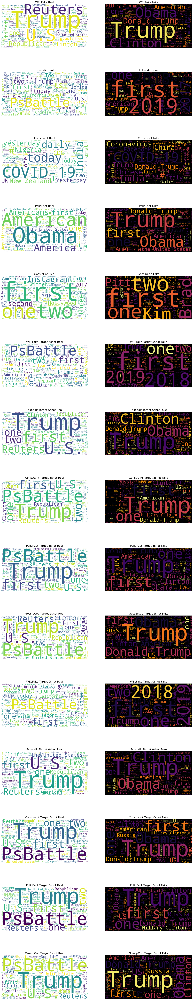

In [61]:
ne_analyzer.plotNamedEntityWordCloudsForRealVsFake(
    ne_freq_dict_concat_df
)

- For the WELFake dataset, both fake news and real news are centred on U.S. politics and feature names of American presidents and institutions. However, an immediate difference between the two word clouds is that the real news word cloud contains the term "Reuters", which is missing from the fake news cloud, thus signalling that *real* US political news may often use Reuters as a cited credible source, while fake news does not.
- For the Fakeddit word clouds, the fake news cloud contains many more *date-related* entities than the real-news cloud. The main entity that stands out as distinctive for the real news cloud is a reference to "PsBattle", which is a sub-reddit for photoshop "battles" ("A place to battle using image manipulation software"), indicating that perhaps many of the "real news" samples were sourced from here.
- For the Constraint COVID-19 dataset, there is a lot of overlap with similar named entities, such as "COVID-19" or "India". However, the real news cloud seems to contain more time-related entities ("daily", "yesterday") compared to the fake news cloud.
- For PolitiFact, the two clouds are very similar, but it is interesting that for real news, the term "the United States" seems to have a higher frequency than for fake news, where acronyms such as "US" are preferred, signalling less formal language.
- For Gossipcop, it is difficult to distinguish key differences between the real and fake news word clouds.
- As such, it may be more helpful to plot the word clouds for the set difference of named entities for real news vs fake news, to identify which entities appear in one set and not the other more easily.

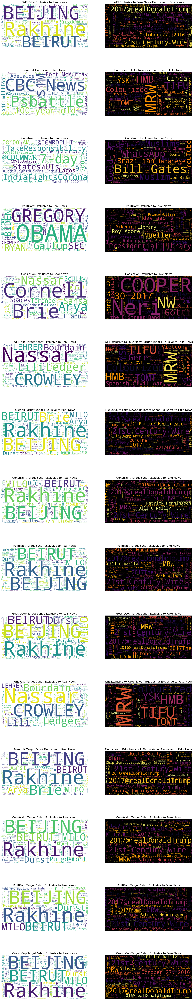

In [62]:
ne_analyzer.plotNamedEntityWordCloudsForRealVsFakeSetDifference(
    ne_freq_dict_concat_df
)

##### Overview of Key Differences in Real vs Fake XOR WordClouds


Displaying word clouds containing references to entities that exist in either fake news or real news but **not** both can help identify the most discriminative features and summarize differences between the two news categories. It is more easy to see which features separate the two classes if common entities are removed, and thus reduce cognitive load and clarify core differences.

Consequently, the examination of these of unique-entity word clouds for real vs fake news exposed interesting patterns in entity distributions, with each dataset showing distinctive properties:

- **WELFake**: Real news contains a lot of references to Rakhine (a state in Myanmar), while fake news does not. In constrast, fake news contains references to the 21st Century Wire source, which is a well-known conspiracy theory news site, thus highlighting its dependence on unreliable sources. Furthermore, fake news entities feature a lot more dates and references containing the string "DonaldTrump".
- **Fakeddit**: fake news contains a **lot** more text-speak and informal (perhaps Reddit-specific) acronysms compared to real news, such as MRW ("My Reaction When"), TIFU ("today I fucked up") and HMB ("hold my beer"). This is an important distinction as it shows the increased usage of platform-specific slang in fake news articles than real news articles.
- **Constraint**: the inclusion of "Bill Gates", "Muslims" and "Japanese" in the fake-news dataset indicates that certain individuals and groups are being singled out and attacked in disinformation articles about COVID-19, as the real-news word clouds has fewer references to famous people or religious and ethnic groups.
- **PolitiFact**: real news contains more references to individuals in all-caps lock, which highlights the importance of not lowercasing the text data for these datasets, as case can be a key distinguishing feature.
- **GossipCop**: the word clouds show that certain entities are targeted more as the topic of gossip-based rumours than are mentioned in real news, such as "the E Street Band", "Neri" and "Hinman".

Overall, these word clouds show that many certain strings and patterns are frequently featured in the fake news category of a dataset but absent from real news, and vice versa. Furthermore, these word clouds indicate that including features such as capitalization counts (for caps-lock on a whole name mainly in real news in PolitiFact, or indicating the prevalence of acronyms in Fakeddit) can be helpful for improving classifier performance. Additionally, presenting a set-difference based word cloud for the real and fake training data can be useful to users, who, in the user interviews and surveys conducted, expressed a preference for seeing word clouds in the final app for highlighting word tendencies and named entity prevalence in the training data.